<a href="https://colab.research.google.com/github/SERVIR/GEDI_Earthhub_ARSET_Training/blob/main/Module_II_Exploring_Forest_Structure_with_GEDI_L2B.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Module II: Exploring Forest Structure with GEDI L2B

run the pip install to to load the needed packages

re-run the cell if/when the restart prompt is given

In [1]:
!pip install earthaccess harmony-py hvplot folium geopandas geoviews

Make a new folder to work in and change directory to that location

In [2]:
!mkdir Module_2_GEDI_L2b

!mkdir Module_2_GEDI_L2b/SPB_AOI
!mkdir Module_2_GEDI_L2b/Prescribed_Burn_AOI
!mkdir Module_2_GEDI_L2b/Sewanee_Domain
!mkdir Module_2_GEDI_L2b/PaintRock_AOI

mkdir: cannot create directory ‘Module_2_GEDI_L2b’: File exists
mkdir: cannot create directory ‘Module_2_GEDI_L2b/SPB_AOI’: File exists
mkdir: cannot create directory ‘Module_2_GEDI_L2b/Prescribed_Burn_AOI’: File exists
mkdir: cannot create directory ‘Module_2_GEDI_L2b/Sewanee_Domain’: File exists
mkdir: cannot create directory ‘Module_2_GEDI_L2b/PaintRock_AOI’: File exists


Change directory to that new folder

In [3]:
%cd /content/Module_2_GEDI_L2b

/content/Module_2_GEDI_L2b


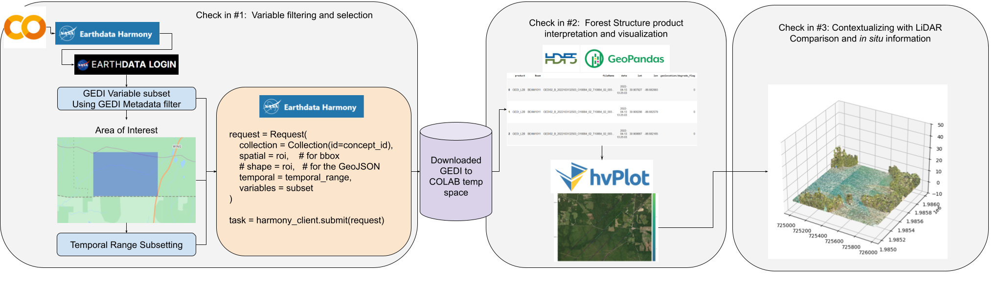

Link to editable workflow (to be removed at the end) https://docs.google.com/drawings/d/1q49Oa-y9W5X25_Qijg0IuSczzcVrcOX5mVfiyIO_UmE/edit

Load the needed packages

In [4]:
from harmony import BBox, Client, Collection, Request, CapabilitiesRequest
from datetime import datetime
import json
import earthaccess
import geopandas as gp
import os
from IPython.display import JSON
import h5py
import pandas as pd
from shapely.geometry import Point
import hvplot.pandas
import folium
from folium import GeoJson
from IPython.display import display, HTML
import requests
from io import StringIO

from datetime import datetime

import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from matplotlib.colors import Normalize
from matplotlib.cm import ScalarMappable, get_cmap
import textwrap


# gv.extension('bokeh', 'matplotlib')
from holoviews import opts
import shapely
import matplotlib.cm as cm
import matplotlib.colors as colors
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns

os.chdir('../../')

## Authenticate

Pause here and set up your arorund and have your username and password ready for this next section. See the [EarthData Login](https://urs.earthdata.nasa.gov/) if you dont have an account yet.

`earthaccess.login()` is used here to access NASA Earthdata Login (EDL) credentials stored in a .netrc file and allows users to type their credentials and persist them to a .netrc file if one does not exist.

In [5]:
auth = earthaccess.login(persist=True)
# auth.token

Enter your Earthdata Login username: tjm0042
Enter your Earthdata password: ··········


To access data through Harmony service, we need to create a Harmony Client object using either your EDL token or your Earthdata Login credentials. Below, `username` and `password` are directly provided to `Client` function. See [here](https://github.com/nasa/harmony-py/blob/main/examples/intro_tutorial.ipynb) for other options you can create Harmony Client object.

In [6]:
harmony_client = Client(auth=(auth.username, auth.password))

# Visualize our Areas of intres (AOI)

Add relivant phyphysical and forest informaiton regarind these sites see  the folder here with the docs to support this: https://drive.google.com/drive/folders/1WvBSUIHy6I05j8s1ZZRarho5qnG2wdnb

In [7]:
# Bring in aois
geojson_urls = {
    "SPB_AOI": "https://raw.githubusercontent.com/SERVIR/GEDI_Earthhub_ARSET_Training/main/AOIs/SPB_AOI.geojson",
    "Prescribed_Burn_AOI": "https://raw.githubusercontent.com/SERVIR/GEDI_Earthhub_ARSET_Training/main/AOIs/prescribed_burn_aoi.geojson",
    "Sewanee_Domain": "https://raw.githubusercontent.com/SERVIR/GEDI_Earthhub_ARSET_Training/main/AOIs/Sewanee_Domain.geojson",
    "PaintRockAOI": "https://raw.githubusercontent.com/SERVIR/GEDI_Earthhub_ARSET_Training/main/AOIs/PaintRockAOI.geojson"
}

In [8]:
# Load GeoJSONs into GeoDataFrames and store map HTML
geojson_gdfs = {}
maps_html = []

def create_map_and_gdf(name, url):
    # Get GeoJSON from URL
    geojson_data = requests.get(url).json()

    # Create GeoDataFrame
    gdf = gp.GeoDataFrame.from_features(geojson_data["features"])
    geojson_gdfs[name] = gdf

    # Determine map center
    coords = geojson_data['features'][0]['geometry']['coordinates']
    geom_type = geojson_data['features'][0]['geometry']['type']

    if geom_type == "Polygon":
        coords = coords[0]
    elif geom_type == "MultiPolygon":
        coords = coords[0][0]
    else:
        raise ValueError(f"Unsupported geometry type: {geom_type}")

    lat = sum(pt[1] for pt in coords) / len(coords)
    lon = sum(pt[0] for pt in coords) / len(coords)

    # Create map
    fmap = folium.Map(location=[lat, lon], zoom_start=13, tiles="OpenStreetMap")
    folium.GeoJson(geojson_data, name=name).add_to(fmap)

    # Return rendered HTML
    return fmap._repr_html_()

# Generate maps and GeoDataFrames
for name, url in geojson_urls.items():
    html_map = create_map_and_gdf(name, url)
    maps_html.append(html_map)


In [9]:
# Display maps side by side
html = f"""
<div style="display: flex; flex-wrap: wrap;">
    {''.join([f'<div style="flex: 1; min-width: 400px; margin: 5px;">{m}</div>' for m in maps_html])}
</div>
"""
display(HTML(html))

In [10]:
##Pull out the geopanda dataframes
SPB_AOI = geojson_gdfs["SPB_AOI"]
Prescribed_Burn_AOI = geojson_gdfs["Prescribed_Burn_AOI"]
Sewanee_Domain = geojson_gdfs["Sewanee_Domain"]
PaintRock_AOI = geojson_gdfs["PaintRockAOI"]

In [11]:
# ## Create a convex hull (total bounds) polyogn of your AOI so Harmony client can download the bounds
# minx, miny, maxx, maxy = SPB_AOI.total_bounds
# SPB_AOI_roi = float(minx), float(miny), float(maxx), float(maxy)

# minx, miny, maxx, maxy = Prescribed_Burn_AOI.total_bounds
# Prescribed_Burn_AOI_roi = float(minx), float(miny), float(maxx), float(maxy)

# minx, miny, maxx, maxy = Sewanee_Domain.total_bounds
# Sewanee_Domain_AOI_roi = float(minx), float(miny), float(maxx), float(maxy)

# minx, miny, maxx, maxy = PaintRock_AOI.total_bounds
# PaintRock_AOI_roi = float(minx), float(miny), float(maxx), float(maxy)

In [12]:
# Store all bbox objects in a dictionary for later use
bbox_dict = {}

for name, url in geojson_urls.items():
    gdf = gp.read_file(url)
    minx, miny, maxx, maxy = gdf.total_bounds
    bbox = BBox(minx, miny, maxx, maxy)
    bbox_dict[f"{name}_roi"] = bbox

bbox_dict


{'SPB_AOI_roi': BBox: West:-87.41249365706668, South:34.14940566292299, East:-87.35970778365359, North:34.1864759501938,
 'Prescribed_Burn_AOI_roi': BBox: West:-86.68320982, South:30.99529573, East:-86.62706739, North:31.02423368,
 'Sewanee_Domain_roi': BBox: West:-85.98971714751701, South:35.127110504508586, East:-85.85727611112807, North:35.235639374867105,
 'PaintRockAOI_roi': BBox: West:-86.31006140840377, South:34.769532701151896, East:-86.30307836070996, North:34.77524552146644}

In [13]:
# SPB_AOI_roi = BBox(-87.41249365706668, 34.14940566292299, -87.35970778365359, 34.1864759501938)
# Prescribed_Burn_AOI_roi = BBox(-86.68320982, 30.99529573, -86.62706739, 31.02423368)
# Sewanee_Domain_AOI_roi = BBox(-85.98971714751701,-85.98971714751701, -85.85727611112807, 35.235639374867105)
# PaintRock_AOI_roi = BBox(-86.31006140840377,34.769532701151896, -86.30307836070996, 34.77524552146644)

## Get the GEDI Collections Harmony Capabilities

First lets investigate what capabilites Harmony has to request data. Using hte short name `'GEDI02_B'`
('GEDI02_A', 'GEDI02_B', 'GEDI01_B')

view informaiton such as `conceptId` such as variable subsetting, bounding box subsetting, shapefile subsetting, concatenation and reprojection, etc.

In [14]:
capabilities = harmony_client.submit(CapabilitiesRequest(short_name='GEDI02_B'))
print(json.dumps(capabilities, indent=2))

{
  "conceptId": "C2142776747-LPCLOUD",
  "shortName": "GEDI02_B",
  "variableSubset": true,
  "bboxSubset": true,
  "shapeSubset": true,
  "temporalSubset": true,
  "concatenate": false,
  "reproject": false,
  "outputFormats": [
    "application/x-hdf"
  ],
  "services": [
    {
      "name": "sds/trajectory-subsetter",
      "href": "https://cmr.earthdata.nasa.gov/search/concepts/S2836723123-XYZ_PROV",
      "capabilities": {
        "subsetting": {
          "temporal": true,
          "bbox": true,
          "shape": true,
          "variable": true
        },
        "output_formats": [
          "application/x-hdf"
        ]
      }
    }
  ],
  "variables": [
    {
      "name": "/BEAM0000/algorithmrun_flag",
      "href": "https://cmr.earthdata.nasa.gov/search/concepts/V2837647264-LPCLOUD"
    },
    {
      "name": "/BEAM0000/ancillary/dz",
      "href": "https://cmr.earthdata.nasa.gov/search/concepts/V2837647474-LPCLOUD"
    },
    {
      "name": "/BEAM0000/ancillary/l2a_al

## Create a Harmony Request

There are several parameters that can be used for the Harmony request. See [the documentation](https://harmony-py.readthedocs.io/en/latest/) and [the introductory Harmony tutorial ](https://github.com/nasa/harmony-py/blob/main/examples/intro_tutorial.ipynb) for more details.



Harmony provides access to services that can transform data from NASA's [Earth Observing Systems Data and Information System (EOSDIS)](https://www.earthdata.nasa.gov/eosdis) Distributed Active Archive Centers (DAAC). [`harmony-py`](https://github.com/nasa/harmony-py) Python package is the recommended way of interacting with Harmony service. This notebook shows how to query and access customized [NASA's LP DAAC](https://lpdaac.usgs.gov/)  GEDI data outputs using [NASA's Harmony Services](https://harmony.earthdata.nasa.gov/).


### GEDI Collection Concept ID

`collection` is a Required parameter. The concept ID, which is the NASA EOSDIS collection ID provided in the Common Metadata Repository [(CMR)](https://cmr.earthdata.nasa.gov/search/site/docs/search/api.html) metadata **OR** Product short name (e.g. 'C2142776747-LPCLOUD') can be provided to search for collections.

Below, `concept_id` is saved to a variable.  

In [15]:
print(capabilities['shortName'], ',', capabilities['conceptId'])

concept_id = capabilities['conceptId']
print("concept_id:", concept_id)

GEDI02_B , C2142776747-LPCLOUD
concept_id: C2142776747-LPCLOUD


### GEDI Variable Subset

Take time to explore GEDI variables of importance via the [GEDI l2b dictionary](https://lpdaac.usgs.gov/documents/980/gedi_l2b_dictionary_P003_v2.html)

In [16]:
#See the append_field.txt which hasd a long dictionary of the fields and products of GEDI
#This ictionary will be used to subset our variables of intrest
#Notice this includes'GEDI01_B','GEDI02_A', and 'GEDI02_B'
append_url = "https://raw.githubusercontent.com/SERVIR/GEDI_Earthhub_ARSET_Training/main/append_field.txt"
append_text = requests.get(append_url).text

start_index = append_text.find("{")
end_index = append_text.rfind("}") + 1
dict_str = append_text[start_index:end_index]

append_dict = eval(dict_str)

In [17]:
#Display the dictionary we will use to subset later
append_dict

{'GEDI_L1B': ['geolocation/altitude_instrument',
  'geolocation/local_beam_elevation',
  'tx_sample_start_index',
  'nsemean_odd',
  'ancillary/master_time_epoch',
  'noise_stddev_corrected',
  'tx_pulseflag',
  'geolocation/longitude_bin0_error',
  'selection_stretchers_x',
  'nsemean_even',
  'geolocation/latitude_instrument',
  'geolocation/digital_elevation_model',
  'geolocation/longitude_instrument_error',
  'geolocation/longitude_lastbin_error',
  'tx_egsigma',
  'geolocation/neutat_delay_total_bin0',
  'rx_energy',
  'master_frac',
  'rx_sample_count',
  'rxwaveform',
  'tx_gloc',
  'ancillary/mean_samples',
  'geolocation/longitude_instrument',
  'tx_eggamma_error',
  'rx_offset',
  'tx_egbias_error',
  'geolocation/bounce_time_offset_lastbin',
  'all_samples_sum',
  'geophys_corr/tide_load',
  'geolocation/solar_azimuth',
  'geolocation/mean_sea_surface',
  'geolocation/neutat_delay_total_lastbin',
  'th_left_used',
  'rx_sample_start_index',
  'geophys_corr/tide_ocean',
  'g

In [18]:
# print only the dictionary fo avaible GEDI 2 B products to explore
gedi_l2b = append_dict.get('GEDI_L2B', {})

# Step 4: Print items under 'GEDI_L2B'
print("Items under 'GEDI_L2B':")
for item in gedi_l2b:
    print(item)

Items under 'GEDI_L2B':
rx_processing/rg_eg_flag_a4
rx_processing/rg_eg_gamma_error_a5
rx_processing/rg_eg_gamma_error_a1
rx_processing/rg_error_a3
rx_processing/rg_eg_amplitude_a2
geolocation/local_beam_elevation
ancillary/rg_eg_constraint_center_buffer
rx_processing/rx_energy_a6
ancillary/tx_noise_stddev_multiplier
pgap_theta_z
rx_processing/rg_eg_center_error_a5
rx_processing/pgap_theta_a4
land_cover_data/modis_nonvegetated
geolocation/longitude_bin0_error
rx_processing/rg_error_a1
geolocation/elev_highestreturn
land_cover_data/landsat_water_persistence
land_cover_data/leaf_on_doy
rx_processing/algorithmrun_flag_a5
geolocation/lon_lowestmode
rx_processing/rx_energy_a4
geolocation/digital_elevation_model
rhov
rx_processing/rg_a5
rx_processing/rg_error_a2
geolocation/longitude_lastbin_error
rx_processing/rg_a6
rx_processing/rg_eg_gamma_a1
l2b_quality_flag
rx_processing/rg_eg_amplitude_error_a4
rx_processing/rg_eg_amplitude_a3
rx_processing/pgap_theta_error_a3
land_cover_data/leaf_off_

Select your variables of intrest

In [19]:
#Selecting the 'GEDI02_B' of intrest to then be downloaded
subset_L2B = ['geolocation/lat_lowestmode', 'geolocation/lon_lowestmode', 'geolocation/degrade_flag', 'geolocation/digital_elevation_model','geolocation/elev_lowestmode','geolocation/elev_highestreturn','l2b_quality_flag','rh100', 'pai', 'fhd_normal']

In [20]:
# subset_L2B = ['geolocation/lat_lowestmode', 'geolocation/lon_lowestmode', 'geolocation/degrade_flag', 'geolocation/digital_elevation_model', 'geolocation/elev_lowestmode', 'lat_highestreturn', 'geolocation/lon_highestreturn', 'geolocation/elev_highestreturn', 'l2b_quality_flag', 'rh100', 'pai', 'pai_z', 'pavd_z','fhd_normal']

In [21]:
### filter those varibales ofintrest out of the larger list
selected_L2B = []
for s in subset_L2B:
    my_var = [v for v in gedi_l2b if v.endswith(f'{s}')]
    if len(my_var) == 1:
        selected_L2B.append(my_var[0])

    elif len(my_var) > 1:
        my_var = [v for v in my_var if v.startswith(f'{s}')]

        for l in my_var:
            if l not in selected_L2B:
                selected_L2B.append(l)

selected_L2B

['geolocation/lat_lowestmode',
 'geolocation/lon_lowestmode',
 'geolocation/degrade_flag',
 'geolocation/digital_elevation_model',
 'geolocation/elev_lowestmode',
 'geolocation/elev_highestreturn',
 'l2b_quality_flag',
 'rh100',
 'pai',
 'fhd_normal']

Select the subset of your desired beams. For instance, you can only select Full Power beams ('BEAM0101', 'BEAM0110', 'BEAM1000', 'BEAM1011').

In [22]:
#Adding one beam select for demonstraiton purposes increase as needed
beams = ['BEAM0101', 'BEAM0110', 'BEAM1000', 'BEAM1011'] #['BEAM0000', 'BEAM0001', 'BEAM0010', 'BEAM0011', 'BEAM0101', 'BEAM0110', 'BEAM1000', 'BEAM1011']

In [23]:
#Append our beams of intrest to our variables of intrest
#the subset list will then be used throughout
subset = []
for b in beams:
    beam_subset = [f'/{b}/{layer}' for layer in selected_L2B]
    [subset.append(i) for i in beam_subset]
subset

['/BEAM0101/geolocation/lat_lowestmode',
 '/BEAM0101/geolocation/lon_lowestmode',
 '/BEAM0101/geolocation/degrade_flag',
 '/BEAM0101/geolocation/digital_elevation_model',
 '/BEAM0101/geolocation/elev_lowestmode',
 '/BEAM0101/geolocation/elev_highestreturn',
 '/BEAM0101/l2b_quality_flag',
 '/BEAM0101/rh100',
 '/BEAM0101/pai',
 '/BEAM0101/fhd_normal',
 '/BEAM0110/geolocation/lat_lowestmode',
 '/BEAM0110/geolocation/lon_lowestmode',
 '/BEAM0110/geolocation/degrade_flag',
 '/BEAM0110/geolocation/digital_elevation_model',
 '/BEAM0110/geolocation/elev_lowestmode',
 '/BEAM0110/geolocation/elev_highestreturn',
 '/BEAM0110/l2b_quality_flag',
 '/BEAM0110/rh100',
 '/BEAM0110/pai',
 '/BEAM0110/fhd_normal',
 '/BEAM1000/geolocation/lat_lowestmode',
 '/BEAM1000/geolocation/lon_lowestmode',
 '/BEAM1000/geolocation/degrade_flag',
 '/BEAM1000/geolocation/digital_elevation_model',
 '/BEAM1000/geolocation/elev_lowestmode',
 '/BEAM1000/geolocation/elev_highestreturn',
 '/BEAM1000/l2b_quality_flag',
 '/BEAM

# Create Request Task and download spatially and vairable subseted H5 Files

In [24]:
# temporal_range = {'start': datetime(2022, 4, 1),
#                   'stop': datetime(2022, 6, 1)}

# request = Request(
#     collection = Collection(id=concept_id),
#     spatial = SPB_AOI_roi,
#     temporal = temporal_range,
#     variables = subset
# )

# print("Check if the request payload per aoi:", request.is_valid())

# task = harmony_client.submit(request)
# print(f'Harmony request ID: {task}')

# print(f'Processing your Harmony request:')
# task_json = harmony_client.result_json(task, show_progress=True)

# results = harmony_client.download_all(task, directory='/content/Module_2_GEDI_L2b/SPB_AOI', overwrite=True)

# file_names = [f.result() for f in results]

In [25]:
# temporal_range = {'start': datetime(2022, 1, 1),
#                   'stop': datetime(2022, 12, 30)}

# request = Request(
#     collection = Collection(id=concept_id),
#     spatial = Prescribed_Burn_AOI_roi,
#     temporal = temporal_range,
#     variables = subset
# )

# print("Check if the request payload per aoi:", request.is_valid())

# task = harmony_client.submit(request)
# print(f'Harmony request ID: {task}')

# print(f'Processing your Harmony request:')
# task_json = harmony_client.result_json(task, show_progress=True)

# results = harmony_client.download_all(task, directory='/content/Module_2_GEDI_L2b/Prescribed_Burn_AOI', overwrite=True)
# results
# file_names = [f.result() for f in results]

In [26]:
# temporal_range = {'start': datetime(2022, 4, 1),
#                   'stop': datetime(2022, 12, 1)}

# request = Request(
#     collection = Collection(id=concept_id),
#     spatial = PaintRock_AOI_roi,
#     temporal = temporal_range,
#     variables = subset
# )

# print("Check if the request payload per aoi:", request.is_valid())

# task = harmony_client.submit(request)
# print(f'Harmony request ID: {task}')

# print(f'Processing your Harmony request:')
# task_json = harmony_client.result_json(task, show_progress=True)

# results = harmony_client.download_all(task, directory='/content/Module_2_GEDI_L2b/PaintRock_AOI', overwrite=True)

# file_names = [f.result() for f in results]

In [27]:
# temporal_range = {'start': datetime(2022, 4, 1),
#                   'stop': datetime(2022, 6, 1)}

# request = Request(
#     collection = Collection(id=concept_id),
#     spatial = Sewanee_Domain_AOI_roi,
#     temporal = temporal_range,
#     variables = subset
# )

# print("Check if the request payload per aoi:", request.is_valid())

# task = harmony_client.submit(request)
# print(f'Harmony request ID: {task}')

# print(f'Processing your Harmony request:')
# task_json = harmony_client.result_json(task, show_progress=True)

# results = harmony_client.download_all(task, directory='/content/Module_2_GEDI_L2b/Sewanee_Domain', overwrite=True)

# file_names = [f.result() for f in results]

These code block creates request tasks via harmony and downloads them to the set directories.
The AOI, time period, and subset variables are used to create the the request


In [28]:
# Define temporal range
temporal_range = {'start': datetime(2019, 4, 1),
                  'stop': datetime(2022, 12, 30)}

In [29]:
# Corresponding output directories
output_dirs = [
    '/content/Module_2_GEDI_L2b/SPB_AOI',
    '/content/Module_2_GEDI_L2b/Prescribed_Burn_AOI',
    '/content/Module_2_GEDI_L2b/PaintRock_AOI',
    '/content/Module_2_GEDI_L2b/Sewanee_Domain'
]

In [30]:
# Loop through paired spatial ROIs and directories
for (spatial, out_dir) in zip(bbox_dict.keys(), output_dirs):
    print(f"\nSubmitting request for: {out_dir}")

    request = Request(
        collection=Collection(id=concept_id),
        spatial=bbox_dict[spatial],  # Use the corresponding BBox from the dictionary
        temporal=temporal_range,
        variables=subset
    )

    print("Check if the request payload is valid:", request.is_valid())

    task = harmony_client.submit(request)
    print(f'Harmony request ID: {task}')

    print('Processing your Harmony request:')
    task_json = harmony_client.result_json(task, show_progress=True)

    results = harmony_client.download_all(task, directory=out_dir, overwrite=True)
    file_names = [f.result() for f in results]

    print(f"Download completed for {out_dir}")



Submitting request for: /content/Module_2_GEDI_L2b/SPB_AOI
Check if the request payload is valid: True


 [ Processing:   0% ] |                                                   | [/]

Harmony request ID: e4d3319d-b754-4d06-adc0-6e31dcb16851
Processing your Harmony request:


 [ Processing: 100% ] |###################################################| [|]


/content/Module_2_GEDI_L2b/SPB_AOI/102479280_GEDI02_B_2019298172214_O04919_03_T01627_02_003_01_V002_subsetted.h5
/content/Module_2_GEDI_L2b/SPB_AOI/102479282_GEDI02_B_2020084054801_O07253_03_T01627_02_003_01_V002_subsetted.h5
/content/Module_2_GEDI_L2b/SPB_AOI/102479285_GEDI02_B_2020319084747_O10898_03_T05743_02_003_01_V002_subsetted.h5
/content/Module_2_GEDI_L2b/SPB_AOI/102479288_GEDI02_B_2021051175317_O12423_03_T05743_02_003_01_V002_subsetted.h5
/content/Module_2_GEDI_L2b/SPB_AOI/102479279_GEDI02_B_2019263001316_O04365_02_T03688_02_003_01_V002_subsetted.h5
/content/Module_2_GEDI_L2b/SPB_AOI/102479289_GEDI02_B_2021117083749_O13440_02_T09380_02_003_01_V002_subsetted.h5
/content/Module_2_GEDI_L2b/SPB_AOI/102479283_GEDI02_B_2020088041519_O07314_03_T02897_02_003_01_V002_subsetted.h5
/content/Module_2_GEDI_L2b/SPB_AOI/102479296_GEDI02_B_2022093011111_O18721_03_T01627_02_003_01_V002_subsetted.h5
/content/Module_2_GEDI_L2b/SPB_AOI/102479278_GEDI02_B_2019230201557_O03866_03_T02897_02_003_01_V

 [ Processing:   0% ] |                                                   | [/]

Harmony request ID: 17e738fd-4bd8-4f5b-ab0c-5049f3ef1ada
Processing your Harmony request:


 [ Processing: 100% ] |###################################################| [|]


/content/Module_2_GEDI_L2b/Prescribed_Burn_AOI/102479306_GEDI02_B_2019193033651_O03281_02_T00750_02_003_01_V002_subsetted.h5
/content/Module_2_GEDI_L2b/Prescribed_Burn_AOI/102479315_GEDI02_B_2021297164948_O16235_03_T09599_02_003_01_V002_subsetted.h5
/content/Module_2_GEDI_L2b/Prescribed_Burn_AOI/102479316_GEDI02_B_2022011020145_O17450_02_T06442_02_003_01_V002_subsetted.h5
/content/Module_2_GEDI_L2b/Prescribed_Burn_AOI/102479308_GEDI02_B_2019309131720_O05087_03_T03907_02_003_01_V002_subsetted.h5
Download completed for /content/Module_2_GEDI_L2b/Prescribed_Burn_AOI

Submitting request for: /content/Module_2_GEDI_L2b/PaintRock_AOI
Check if the request payload is valid: True


 [ Processing:   0% ] |                                                   | [/]

Harmony request ID: 7c2bcd17-fe94-4c2e-b1c8-9326d613f1bd
Processing your Harmony request:


 [ Processing: 100% ] |###################################################| [|]


/content/Module_2_GEDI_L2b/PaintRock_AOI/102479331_GEDI02_B_2019312044317_O05128_02_T02571_02_003_01_V002_subsetted.h5
/content/Module_2_GEDI_L2b/PaintRock_AOI/102479333_GEDI02_B_2020182144232_O08778_03_T00311_02_003_01_V002_subsetted.h5
/content/Module_2_GEDI_L2b/PaintRock_AOI/102479327_GEDI02_B_2019138014405_O02426_02_T03841_02_003_01_V002_subsetted.h5
/content/Module_2_GEDI_L2b/PaintRock_AOI/102479332_GEDI02_B_2019337015939_O05514_03_T01887_02_003_01_V002_subsetted.h5
/content/Module_2_GEDI_L2b/PaintRock_AOI/102479350_GEDI02_B_2022177153027_O20033_03_T01887_02_003_02_V002_subsetted.h5
/content/Module_2_GEDI_L2b/PaintRock_AOI/102479326_GEDI02_B_2019122150008_O02186_03_T04733_02_003_01_V002_subsetted.h5
/content/Module_2_GEDI_L2b/PaintRock_AOI/102479340_GEDI02_B_2021232110553_O15224_02_T11109_02_003_01_V002_subsetted.h5
/content/Module_2_GEDI_L2b/PaintRock_AOI/102479344_GEDI02_B_2022016072349_O17531_03_T07426_02_003_01_V002_subsetted.h5
/content/Module_2_GEDI_L2b/PaintRock_AOI/1024793

 [ Processing:   0% ] |                                                   | [/]

Harmony request ID: dce3ad8e-1424-4fce-8442-059fb8137b25
Processing your Harmony request:


 [ Processing: 100% ] |###################################################| [|]


/content/Module_2_GEDI_L2b/Sewanee_Domain/102479376_GEDI02_B_2019289134028_O04777_02_T05417_02_003_01_V002_subsetted.h5
/content/Module_2_GEDI_L2b/Sewanee_Domain/102479384_GEDI02_B_2022183060859_O20120_02_T05417_02_003_02_V002_subsetted.h5
/content/Module_2_GEDI_L2b/Sewanee_Domain/102479379_GEDI02_B_2021162214800_O14146_03_T11236_02_003_01_V002_subsetted.h5
/content/Module_2_GEDI_L2b/Sewanee_Domain/102479375_GEDI02_B_2019168204100_O02904_03_T04427_02_003_01_V002_subsetted.h5
/content/Module_2_GEDI_L2b/Sewanee_Domain/102479387_GEDI02_B_2022348194735_O22688_03_T11236_02_003_01_V002_subsetted.h5
Download completed for /content/Module_2_GEDI_L2b/Sewanee_Domain


In [31]:
# # Loop through paired spatial ROIs and directories
# for spatial, out_dir in zip(spatial_rois, output_dirs):
#     print(f"\nSubmitting request for: {out_dir}")

#     request = Request(
#         collection=Collection(id=concept_id),
#         spatial=bbox_dict['SPB_AOI_roi'],
#         temporal=temporal_range,
#         variables=subset
#     )

#     print("Check if the request payload is valid:", request.is_valid())

#     task = harmony_client.submit(request)
#     print(f'Harmony request ID: {task}')

#     print('Processing your Harmony request:')
#     task_json = harmony_client.result_json(task, show_progress=True)

#     results = harmony_client.download_all(task, directory=out_dir, overwrite=True)
#     file_names = [f.result() for f in results]

#     print(f"Download completed for {out_dir}")


In [32]:
## confirm files are in the right spots
!find /content/Module_2_GEDI_L2b

/content/Module_2_GEDI_L2b
/content/Module_2_GEDI_L2b/Sewanee_Domain
/content/Module_2_GEDI_L2b/Sewanee_Domain/102479376_GEDI02_B_2019289134028_O04777_02_T05417_02_003_01_V002_subsetted.h5
/content/Module_2_GEDI_L2b/Sewanee_Domain/102479375_GEDI02_B_2019168204100_O02904_03_T04427_02_003_01_V002_subsetted.h5
/content/Module_2_GEDI_L2b/Sewanee_Domain/102479384_GEDI02_B_2022183060859_O20120_02_T05417_02_003_02_V002_subsetted.h5
/content/Module_2_GEDI_L2b/Sewanee_Domain/102479387_GEDI02_B_2022348194735_O22688_03_T11236_02_003_01_V002_subsetted.h5
/content/Module_2_GEDI_L2b/Sewanee_Domain/102479379_GEDI02_B_2021162214800_O14146_03_T11236_02_003_01_V002_subsetted.h5
/content/Module_2_GEDI_L2b/SPB_AOI
/content/Module_2_GEDI_L2b/SPB_AOI/102479291_GEDI02_B_2021292112336_O16154_02_T10956_02_003_01_V002_subsetted.h5
/content/Module_2_GEDI_L2b/SPB_AOI/102479288_GEDI02_B_2021051175317_O12423_03_T05743_02_003_01_V002_subsetted.h5
/content/Module_2_GEDI_L2b/SPB_AOI/102479284_GEDI02_B_2020196021509_O0

Function is defined to create a DataFrame from our HDF5 Harmony subset file. Next, `GeoDataFrame` is created for all the downloaded subset file.

In [33]:
# def h5_to_dataframe(ds, beams, vars):
#     """
#     This function takes Harmony subset of GEDI hdf5 and returns a DataFrame.
#     """
#     import h5py
#     import pandas as pd
#     from datetime import datetime

#     # Read the dataset
#     gedi_ds = h5py.File(ds, 'r')

#     # Extract metadata
#     product = gedi_ds['METADATA']['DatasetIdentification'].attrs['shortName']
#     fileName = gedi_ds['METADATA']['DatasetIdentification'].attrs['fileName']
#     date = datetime.strptime(fileName.rsplit('_')[2], '%Y%j%H%M%S').strftime('%Y-%m-%d %H:%M:%S')

#     # Create an empty DataFrame for this beam
#     df_beam = pd.DataFrame(columns=vars)

#     for b in beams:
#         data_dic = {}
#         for v in vars:
#             try:
#                 value = gedi_ds[f'{b}/{v}'][()]
#                 data_dic[v] = value.tolist()
#             except KeyError:
#                 print(f"Variable {v} not found in {b} of {ds}")
#                 data_dic[v] = []

#         df_beam = pd.concat([df_beam, pd.DataFrame(data_dic)], join="inner")

#         # Add product, beam, file name, and date columns
#         df_beam.insert(0, 'product', product)
#         df_beam.insert(1, 'Beam', b)
#         df_beam.insert(2, 'fileName', fileName)
#         df_beam.insert(3, 'date', date)

#     return df_beam.reset_index(drop=True)


In [34]:
# import os
# import glob
# import h5py
# import pandas as pd
# import geopandas as gp
# from shapely.geometry import Point
# from datetime import datetime

# # List of directories to search for .h5 files
# output_dirs = [
#     '/content/Module_2_GEDI_L2b/SPB_AOI',
#     '/content/Module_2_GEDI_L2b/Prescribed_Burn_AOI',
#     '/content/Module_2_GEDI_L2b/PaintRock_AOI',
#     '/content/Module_2_GEDI_L2b/Sewanee_Domain'
# ]

# # Define the list of GEDI beams
# beams = ['BEAM0000', 'BEAM0001', 'BEAM0010', 'BEAM0011',
#          'BEAM0101', 'BEAM0110', 'BEAM1000', 'BEAM1011']

# # Variables (datasets) to extract from each beam
# datasets_p = [
#     'geolocation/lat_lowestmode',
#     'geolocation/lon_lowestmode',
#     'rh100',
#     'quality_flag'
# ]

# # Create an empty DataFrame to store all results
# l2b_df = pd.DataFrame()

# # Loop through each directory and each file inside
# for directory in output_dirs:
#     file_names = glob.glob(os.path.join(directory, '*.h5'))

#     for file in file_names:
#         print(f"Processing file: {file}")
#         try:
#             gedi_subset = h5_to_dataframe(file, beams, datasets_p)
#             l2b_df = pd.concat([l2b_df, gedi_subset], ignore_index=True)
#             del gedi_subset
#         except Exception as e:
#             print(f"Error processing {file}: {e}")

# # Rename lat/lon for clarity
# l2b_df = l2b_df.rename(columns={
#     'geolocation/lat_lowestmode': 'lat',
#     'geolocation/lon_lowestmode': 'lon'
# })

# # Convert to GeoDataFrame with geometry column
# l2b_df = gp.GeoDataFrame(
#     l2b_df,
#     geometry=l2b_df.apply(lambda row: Point(row.lon, row.lat), axis=1),
#     crs="EPSG:4326"
# )


Explore one of the downloaded h5 files

In [49]:
import os
import h5py

# Directory containing the HDF5 files
folder_path = '/content/Module_2_GEDI_L2b/SPB_AOI'

# Get the first .h5 file in the directory
files = [f for f in os.listdir(folder_path) if f.endswith('.h5')]
if not files:
    raise FileNotFoundError("No .h5 files found in the directory.")

first_file_path = os.path.join(folder_path, files[0])
print(f"Using file: {first_file_path}")

# Open and explore the HDF5 file
with h5py.File(first_file_path, 'r') as f:
    print("\nTop-level groups:")
    print(list(f.keys()))

    print("\nAvailable beams:")
    beams_found = [k for k in f.keys() if k.startswith("BEAM")]
    print(beams_found)

    for beam in beams_found:
        print(f"\nVariables in {beam}:")
        print(list(f[beam].keys()))



Using file: /content/Module_2_GEDI_L2b/SPB_AOI/102479291_GEDI02_B_2021292112336_O16154_02_T10956_02_003_01_V002_subsetted.h5

Top-level groups:
['BEAM0101', 'BEAM0110', 'BEAM1000', 'BEAM1011', 'METADATA']

Available beams:
['BEAM0101', 'BEAM0110', 'BEAM1000', 'BEAM1011']

Variables in BEAM0101:
['fhd_normal', 'geolocation', 'l2b_quality_flag', 'pai', 'rh100']

Variables in BEAM0110:
['fhd_normal', 'geolocation', 'l2b_quality_flag', 'pai', 'rh100']

Variables in BEAM1000:
['fhd_normal', 'geolocation', 'l2b_quality_flag', 'pai', 'rh100']

Variables in BEAM1011:
['fhd_normal', 'geolocation', 'l2b_quality_flag', 'pai', 'rh100']


In [36]:
### open each h5 file grab the data and convert it to a table
def h5_to_dataframe(ds, beams, vars):
    gedi_ds = h5py.File(ds, 'r')
    product = gedi_ds['METADATA']['DatasetIdentification'].attrs['shortName']
    fileName = gedi_ds['METADATA']['DatasetIdentification'].attrs['fileName']
    date = datetime.strptime(fileName.rsplit('_')[2], '%Y%j%H%M%S').strftime('%Y-%m-%d %H:%M:%S')

    df_beam = pd.DataFrame(columns=vars)

    for b in beams:
        data_dic = {}
        try:
            for v in vars:
                value = gedi_ds[f'{b}/{v}'][()]
                data_dic[v] = value.tolist()
            beam_df = pd.DataFrame(data_dic)
            beam_df.insert(0, 'product', product)
            beam_df.insert(1, 'Beam', b)
            beam_df.insert(2, 'fileName', fileName)
            beam_df.insert(3, 'date', date)
            df_beam = pd.concat([df_beam, beam_df], ignore_index=True)
        except Exception as e:
            print(f"    ⚠️ Skipping beam {b} in file {fileName} due to error: {e}")
            continue

    return df_beam.reset_index(drop=True)

# Storage
geo_dfs = {}

# Loop through folders
for folder in output_dirs:
    print(f"Processing folder: {folder}")
    file_names = [os.path.join(folder, f) for f in os.listdir(folder) if f.endswith('.h5')]
    l2b_df = pd.DataFrame()

    for file in file_names:
        print(f"  Reading file: {file}")
        try:
            gedi_subset = h5_to_dataframe(file, beams, subset_L2B)
            l2b_df = pd.concat([l2b_df, gedi_subset], ignore_index=True)
        except Exception as e:
            print(f"    ⚠️ Skipping {file} due to error: {e}")
            continue

    if not l2b_df.empty:
        l2b_df = l2b_df.rename(columns={
            'geolocation/lat_lowestmode': 'lat',
            'geolocation/lon_lowestmode': 'lon'
        })
        l2b_df = gp.GeoDataFrame(
            l2b_df,
            geometry=l2b_df.apply(lambda row: Point(row.lon, row.lat), axis=1),
            crs="EPSG:4326"
        )
        geo_dfs[os.path.basename(folder)] = l2b_df
    else:
        print(f"    ⚠️ No valid data found in {folder}")


Processing folder: /content/Module_2_GEDI_L2b/SPB_AOI
  Reading file: /content/Module_2_GEDI_L2b/SPB_AOI/102479291_GEDI02_B_2021292112336_O16154_02_T10956_02_003_01_V002_subsetted.h5
  Reading file: /content/Module_2_GEDI_L2b/SPB_AOI/102479288_GEDI02_B_2021051175317_O12423_03_T05743_02_003_01_V002_subsetted.h5
    ⚠️ Skipping beam BEAM1000 in file GEDI02_B_2021051175317_O12423_03_T05743_02_003_01_V002.h5 due to error: 'Unable to synchronously open object (component not found)'
    ⚠️ Skipping beam BEAM1011 in file GEDI02_B_2021051175317_O12423_03_T05743_02_003_01_V002.h5 due to error: 'Unable to synchronously open object (component not found)'
  Reading file: /content/Module_2_GEDI_L2b/SPB_AOI/102479284_GEDI02_B_2020196021509_O08987_02_T05264_02_003_01_V002_subsetted.h5
    ⚠️ Skipping beam BEAM0110 in file GEDI02_B_2020196021509_O08987_02_T05264_02_003_01_V002.h5 due to error: 'Unable to synchronously open object (component not found)'
    ⚠️ Skipping beam BEAM1000 in file GEDI02_B_20

/tmp/ipython-input-36-3349246431.py:21: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_beam = pd.concat([df_beam, beam_df], ignore_index=True)
/tmp/ipython-input-36-3349246431.py:21: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_beam = pd.concat([df_beam, beam_df], ignore_index=True)
/tmp/ipython-input-36-3349246431.py:21: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA column

  Reading file: /content/Module_2_GEDI_L2b/SPB_AOI/102479285_GEDI02_B_2020319084747_O10898_03_T05743_02_003_01_V002_subsetted.h5
    ⚠️ Skipping beam BEAM1000 in file GEDI02_B_2020319084747_O10898_03_T05743_02_003_01_V002.h5 due to error: 'Unable to synchronously open object (component not found)'
    ⚠️ Skipping beam BEAM1011 in file GEDI02_B_2020319084747_O10898_03_T05743_02_003_01_V002.h5 due to error: 'Unable to synchronously open object (component not found)'
  Reading file: /content/Module_2_GEDI_L2b/SPB_AOI/102479278_GEDI02_B_2019230201557_O03866_03_T02897_02_003_01_V002_subsetted.h5
  Reading file: /content/Module_2_GEDI_L2b/SPB_AOI/102479297_GEDI02_B_2022123130656_O19194_03_T08589_02_003_01_V002_subsetted.h5
  Reading file: /content/Module_2_GEDI_L2b/SPB_AOI/102479289_GEDI02_B_2021117083749_O13440_02_T09380_02_003_01_V002_subsetted.h5
  Reading file: /content/Module_2_GEDI_L2b/SPB_AOI/102479282_GEDI02_B_2020084054801_O07253_03_T01627_02_003_01_V002_subsetted.h5
    ⚠️ Skipping

/tmp/ipython-input-36-3349246431.py:21: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_beam = pd.concat([df_beam, beam_df], ignore_index=True)
/tmp/ipython-input-36-3349246431.py:21: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_beam = pd.concat([df_beam, beam_df], ignore_index=True)
/tmp/ipython-input-36-3349246431.py:21: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA column

  Reading file: /content/Module_2_GEDI_L2b/SPB_AOI/102479286_GEDI02_B_2020339010136_O11203_03_T08589_02_003_01_V002_subsetted.h5
  Reading file: /content/Module_2_GEDI_L2b/SPB_AOI/102479296_GEDI02_B_2022093011111_O18721_03_T01627_02_003_01_V002_subsetted.h5
    ⚠️ Skipping beam BEAM0101 in file GEDI02_B_2022093011111_O18721_03_T01627_02_003_01_V002.h5 due to error: 'Unable to synchronously open object (component not found)'
    ⚠️ Skipping beam BEAM0110 in file GEDI02_B_2022093011111_O18721_03_T01627_02_003_01_V002.h5 due to error: 'Unable to synchronously open object (component not found)'
  Reading file: /content/Module_2_GEDI_L2b/SPB_AOI/102479279_GEDI02_B_2019263001316_O04365_02_T03688_02_003_01_V002_subsetted.h5
    ⚠️ Skipping beam BEAM0101 in file GEDI02_B_2019263001316_O04365_02_T03688_02_003_01_V002.h5 due to error: 'Unable to synchronously open object (component not found)'
    ⚠️ Skipping beam BEAM0110 in file GEDI02_B_2019263001316_O04365_02_T03688_02_003_01_V002.h5 due to 

/tmp/ipython-input-36-3349246431.py:21: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_beam = pd.concat([df_beam, beam_df], ignore_index=True)
/tmp/ipython-input-36-3349246431.py:21: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_beam = pd.concat([df_beam, beam_df], ignore_index=True)
/tmp/ipython-input-36-3349246431.py:21: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA column

    ⚠️ Skipping beam BEAM1011 in file GEDI02_B_2019309131720_O05087_03_T03907_02_003_01_V002.h5 due to error: 'Unable to synchronously open object (component not found)'
  Reading file: /content/Module_2_GEDI_L2b/Prescribed_Burn_AOI/102479316_GEDI02_B_2022011020145_O17450_02_T06442_02_003_01_V002_subsetted.h5
    ⚠️ Skipping beam BEAM0101 in file GEDI02_B_2022011020145_O17450_02_T06442_02_003_01_V002.h5 due to error: 'Unable to synchronously open object (component not found)'
  Reading file: /content/Module_2_GEDI_L2b/Prescribed_Burn_AOI/102479315_GEDI02_B_2021297164948_O16235_03_T09599_02_003_01_V002_subsetted.h5
Processing folder: /content/Module_2_GEDI_L2b/PaintRock_AOI
  Reading file: /content/Module_2_GEDI_L2b/PaintRock_AOI/102479346_GEDI02_B_2022062130418_O18248_03_T10425_02_003_01_V002_subsetted.h5
  Reading file: /content/Module_2_GEDI_L2b/PaintRock_AOI/102479343_GEDI02_B_2021298160332_O16250_03_T10425_02_003_01_V002_subsetted.h5
  Reading file: /content/Module_2_GEDI_L2b/Paint

/tmp/ipython-input-36-3349246431.py:21: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_beam = pd.concat([df_beam, beam_df], ignore_index=True)
/tmp/ipython-input-36-3349246431.py:21: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_beam = pd.concat([df_beam, beam_df], ignore_index=True)
/tmp/ipython-input-36-3349246431.py:21: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA column

  Reading file: /content/Module_2_GEDI_L2b/PaintRock_AOI/102479348_GEDI02_B_2022110105831_O18991_02_T02571_02_003_01_V002_subsetted.h5
  Reading file: /content/Module_2_GEDI_L2b/PaintRock_AOI/102479341_GEDI02_B_2021238154634_O15320_03_T07579_02_003_01_V002_subsetted.h5
    ⚠️ Skipping beam BEAM0101 in file GEDI02_B_2021238154634_O15320_03_T07579_02_003_01_V002.h5 due to error: 'Unable to synchronously open object (component not found)'
    ⚠️ Skipping beam BEAM0110 in file GEDI02_B_2021238154634_O15320_03_T07579_02_003_01_V002.h5 due to error: 'Unable to synchronously open object (component not found)'
    ⚠️ Skipping beam BEAM1000 in file GEDI02_B_2021238154634_O15320_03_T07579_02_003_01_V002.h5 due to error: 'Unable to synchronously open object (component not found)'
  Reading file: /content/Module_2_GEDI_L2b/PaintRock_AOI/102479331_GEDI02_B_2019312044317_O05128_02_T02571_02_003_01_V002_subsetted.h5
    ⚠️ Skipping beam BEAM1011 in file GEDI02_B_2019312044317_O05128_02_T02571_02_003_

/tmp/ipython-input-36-3349246431.py:21: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_beam = pd.concat([df_beam, beam_df], ignore_index=True)
/tmp/ipython-input-36-3349246431.py:21: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_beam = pd.concat([df_beam, beam_df], ignore_index=True)
/tmp/ipython-input-36-3349246431.py:21: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA column

  Reading file: /content/Module_2_GEDI_L2b/PaintRock_AOI/102479349_GEDI02_B_2022139064237_O19438_03_T04580_02_003_01_V002_subsetted.h5
    ⚠️ Skipping beam BEAM1000 in file GEDI02_B_2022139064237_O19438_03_T04580_02_003_01_V002.h5 due to error: 'Unable to synchronously open object (component not found)'
    ⚠️ Skipping beam BEAM1011 in file GEDI02_B_2022139064237_O19438_03_T04580_02_003_01_V002.h5 due to error: 'Unable to synchronously open object (component not found)'
  Reading file: /content/Module_2_GEDI_L2b/PaintRock_AOI/102479350_GEDI02_B_2022177153027_O20033_03_T01887_02_003_02_V002_subsetted.h5
  Reading file: /content/Module_2_GEDI_L2b/PaintRock_AOI/102479334_GEDI02_B_2020196021509_O08987_02_T05264_02_003_01_V002_subsetted.h5
  Reading file: /content/Module_2_GEDI_L2b/PaintRock_AOI/102479332_GEDI02_B_2019337015939_O05514_03_T01887_02_003_01_V002_subsetted.h5
  Reading file: /content/Module_2_GEDI_L2b/PaintRock_AOI/102479342_GEDI02_B_2021288125533_O16093_02_T09533_02_003_01_V00

/tmp/ipython-input-36-3349246431.py:21: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_beam = pd.concat([df_beam, beam_df], ignore_index=True)
/tmp/ipython-input-36-3349246431.py:21: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_beam = pd.concat([df_beam, beam_df], ignore_index=True)
/tmp/ipython-input-36-3349246431.py:21: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA column

    ⚠️ Skipping beam BEAM1000 in file GEDI02_B_2021131101046_O13658_03_T04580_02_003_01_V002.h5 due to error: 'Unable to synchronously open object (component not found)'
    ⚠️ Skipping beam BEAM1011 in file GEDI02_B_2021131101046_O13658_03_T04580_02_003_01_V002.h5 due to error: 'Unable to synchronously open object (component not found)'
  Reading file: /content/Module_2_GEDI_L2b/PaintRock_AOI/102479328_GEDI02_B_2019209043943_O03530_03_T03157_02_003_01_V002_subsetted.h5
  Reading file: /content/Module_2_GEDI_L2b/PaintRock_AOI/102479329_GEDI02_B_2019210205202_O03556_02_T00995_02_003_01_V002_subsetted.h5
  Reading file: /content/Module_2_GEDI_L2b/PaintRock_AOI/102479353_GEDI02_B_2022289120454_O21768_02_T09533_02_003_01_V002_subsetted.h5
  Reading file: /content/Module_2_GEDI_L2b/PaintRock_AOI/102479327_GEDI02_B_2019138014405_O02426_02_T03841_02_003_01_V002_subsetted.h5
  Reading file: /content/Module_2_GEDI_L2b/PaintRock_AOI/102479355_GEDI02_B_2022352181058_O22749_03_T07426_02_003_01_V00

/tmp/ipython-input-36-3349246431.py:21: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_beam = pd.concat([df_beam, beam_df], ignore_index=True)
/tmp/ipython-input-36-3349246431.py:21: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_beam = pd.concat([df_beam, beam_df], ignore_index=True)
/tmp/ipython-input-36-3349246431.py:21: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA column

Processing folder: /content/Module_2_GEDI_L2b/Sewanee_Domain
  Reading file: /content/Module_2_GEDI_L2b/Sewanee_Domain/102479376_GEDI02_B_2019289134028_O04777_02_T05417_02_003_01_V002_subsetted.h5
    ⚠️ Skipping beam BEAM0101 in file GEDI02_B_2019289134028_O04777_02_T05417_02_003_01_V002.h5 due to error: 'Unable to synchronously open object (component not found)'
    ⚠️ Skipping beam BEAM1000 in file GEDI02_B_2019289134028_O04777_02_T05417_02_003_01_V002.h5 due to error: 'Unable to synchronously open object (component not found)'
    ⚠️ Skipping beam BEAM1011 in file GEDI02_B_2019289134028_O04777_02_T05417_02_003_01_V002.h5 due to error: 'Unable to synchronously open object (component not found)'
  Reading file: /content/Module_2_GEDI_L2b/Sewanee_Domain/102479375_GEDI02_B_2019168204100_O02904_03_T04427_02_003_01_V002_subsetted.h5
    ⚠️ Skipping beam BEAM0101 in file GEDI02_B_2019168204100_O02904_03_T04427_02_003_01_V002.h5 due to error: 'Unable to synchronously open object (component

/tmp/ipython-input-36-3349246431.py:21: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_beam = pd.concat([df_beam, beam_df], ignore_index=True)
/tmp/ipython-input-36-3349246431.py:21: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_beam = pd.concat([df_beam, beam_df], ignore_index=True)
/tmp/ipython-input-36-3349246431.py:21: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA column

In [37]:
#in case the convert to lat  and lon goes wrong helper script to fix
# # Get the Sewanee_Domain GeoDataFrame
# sewanee_df = geo_dfs.get('Sewanee_Domain', gp.GeoDataFrame())

# if not sewanee_df.empty:
#     # Fix the latitude sign by taking the absolute value
#     sewanee_df['lat'] = sewanee_df['lat'].abs()

#     # Also update the geometry column accordingly
#     sewanee_df['geometry'] = sewanee_df.apply(lambda row: Point(row['lon'], row['lat']), axis=1)

#     # Save back to the dictionary
#     geo_dfs['Sewanee_Domain'] = sewanee_df

#     print("Sewanee_Domain latitudes corrected.")
# else:
#     print("Sewanee_Domain GeoDataFrame is empty, nothing to fix.")


In [78]:
#save the dataframes as csvs
for out_dir in output_dirs:
    # Extract folder name only (e.g., 'SPB_AOI')
    aoi_name = os.path.basename(out_dir)

    # Get corresponding GeoDataFrame
    gdf = geo_dfs.get(aoi_name)

    if gdf is not None and not gdf.empty:
        # Define CSV path
        csv_path = os.path.join(out_dir, f"{aoi_name}_GEDI_L2B.csv")

        # Drop the geometry column (optional, if you only want flat CSV)
        gdf_no_geom = gdf.drop(columns='geometry')

        # Save as CSV
        gdf_no_geom.to_csv(csv_path, index=False)
        print(f"✅ Saved: {csv_path}")
    else:
        print(f"⚠️ Skipped: {aoi_name} (no data)")


✅ Saved: /content/Module_2_GEDI_L2b/SPB_AOI/SPB_AOI_GEDI_L2B.csv
✅ Saved: /content/Module_2_GEDI_L2b/Prescribed_Burn_AOI/Prescribed_Burn_AOI_GEDI_L2B.csv
✅ Saved: /content/Module_2_GEDI_L2b/PaintRock_AOI/PaintRock_AOI_GEDI_L2B.csv
✅ Saved: /content/Module_2_GEDI_L2b/Sewanee_Domain/Sewanee_Domain_GEDI_L2B.csv


In [79]:
##pull the dataframes from the dict created above

SPB_AOI = geo_dfs.get('SPB_AOI', gp.GeoDataFrame())
Prescribed_Burn_AOI = geo_dfs.get('Prescribed_Burn_AOI', gp.GeoDataFrame())
PaintRock_AOI = geo_dfs.get('PaintRock_AOI', gp.GeoDataFrame())
Sewanee_Domain = geo_dfs.get('Sewanee_Domain', gp.GeoDataFrame())

Sewanee_Domain.head()

,lat,lon,geolocation/degrade_flag,geolocation/digital_elevation_model,geolocation/elev_lowestmode,geolocation/elev_highestreturn,l2b_quality_flag,rh100,pai,fhd_normal,product,Beam,fileName,date,geometry
0,34.769710,-86.307274,0,248.305832,1649.100952,1680.244507,0,3113,4.26757,3.343379,GEDI_L2B,BEAM0110,GEDI02_B_2019289134028_O04777_02_T05417_02_003...,2019-10-16 13:40:28,POINT (-86.30727 34.76971)
1,34.770071,-86.306809,0,238.559845,1626.900391,1670.718384,0,4381,-9999.00000,-9999.000000,GEDI_L2B,BEAM0110,GEDI02_B_2019289134028_O04777_02_T05417_02_003...,2019-10-16 13:40:28,POINT (-86.30681 34.77007)
2,34.770428,-86.306348,0,238.559845,1614.656494,1639.107788,0,2445,-9999.00000,-9999.000000,GEDI_L2B,BEAM0110,GEDI02_B_2019289134028_O04777_02_T05417_02_003...,2019-10-16 13:40:28,POINT (-86.30635 34.77043)
3,34.770789,-86.305882,0,231.632080,1592.322876,1617.372314,0,2504,-9999.00000,-9999.000000,GEDI_L2B,BEAM0110,GEDI02_B_2019289134028_O04777_02_T05417_02_003...,2019-10-16 13:40:28,POINT (-86.30588 34.77079)
4,34.771136,-86.305433,0,231.632080,1605.121826,1645.238403,0,4011,-9999.00000,-9999.000000,GEDI_L2B,BEAM0110,GEDI02_B_2019289134028_O04777_02_T05417_02_003...,2019-10-16 13:40:28,POINT (-86.30543 34.77114)


# Explore Quality Filtering

/tmp/ipython-input-75-2856432488.py:13: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = get_cmap('plasma')


AttributeError: 'NoneType' object has no attribute 'canvas'

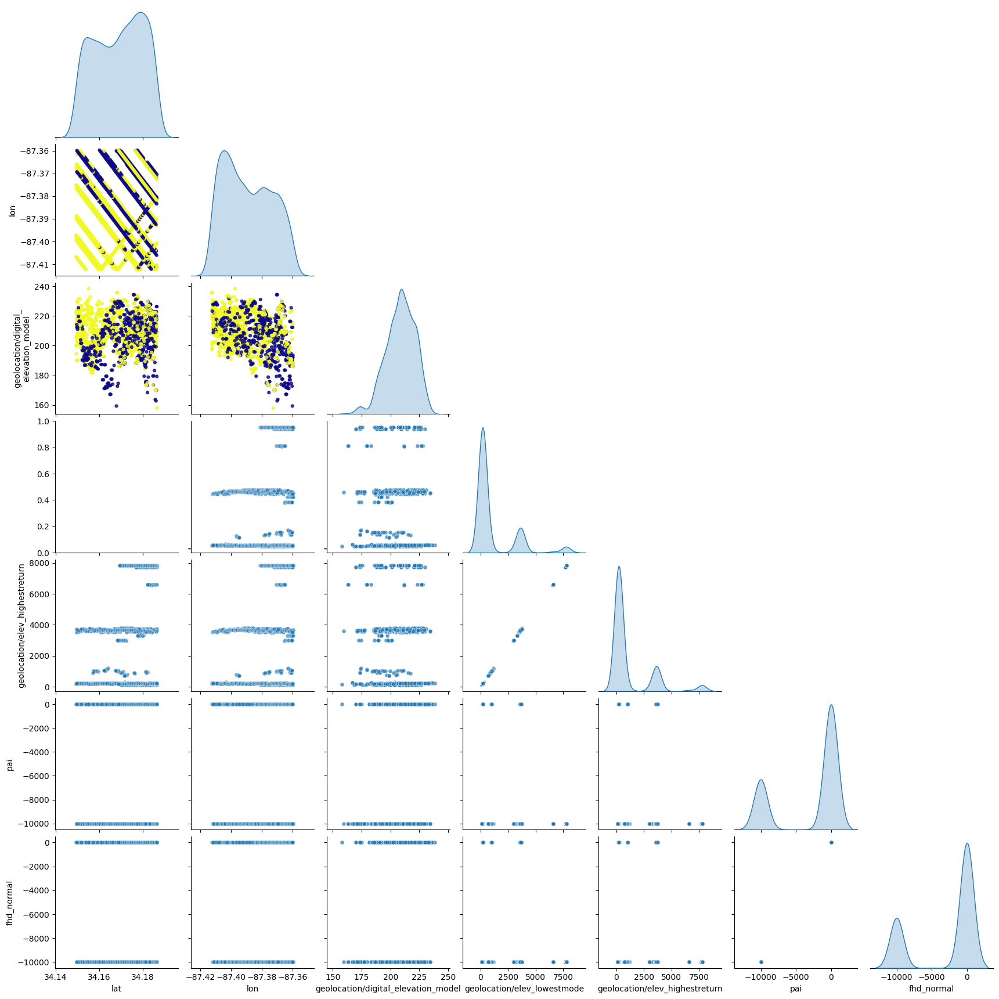

In [75]:
#### Pairplot on the filtered datasets
#### This consolidates all sites and displays the genral behavior of the data
for aoi_name, gdf in geo_dfs.items():
    # Select numeric columns only
    numeric_cols = gdf.select_dtypes(include=[np.number]).columns.tolist()
    if 'fhd_normal' not in numeric_cols or gdf.empty:
        print(f"Skipping {aoi_name} (no numeric data or missing fhd_normal)")
        continue

    # Drop NaNs for numeric fields
    plot_df = gdf[numeric_cols].dropna()

    # Normalize fhd_normal for coloring
    norm = Normalize(vmin=plot_df['fhd_normal'].min(), vmax=plot_df['fhd_normal'].max())
    cmap = get_cmap('plasma')
    colors = cmap(norm(plot_df['fhd_normal'].values))

    # Create pairplot
    pair_grid = sns.pairplot(
        plot_df,
        corner=True,
        plot_kws={'s': 25, 'alpha': 0.7},
        diag_kind='kde'
    )

    # Apply color manually to lower triangle scatterplots
    for i, j in zip(*np.tril_indices_from(pair_grid.axes, -1)):
        ax = pair_grid.axes[i, j]
        x = plot_df.iloc[:, j]
        y = plot_df.iloc[:, i]
        ax.clear()
        ax.scatter(x, y, c=colors, s=12, alpha=0.8)

        # Verbose and wrapped labels
        xlabel = textwrap.fill(plot_df.columns[j], 20)
        ylabel = textwrap.fill(plot_df.columns[i], 20)
        ax.set_xlabel(xlabel, fontsize=10)
        ax.set_ylabel(ylabel, fontsize=10)

    # Ensure all axis tick labels are visible and readable
    for ax_row in pair_grid.axes:
        for ax in ax_row:
            if ax:
                ax.tick_params(labelsize=8)
                if ax.get_xlabel():
                    ax.set_xlabel(textwrap.fill(ax.get_xlabel(), 20), fontsize=9)
                if ax.get_ylabel():
                    ax.set_ylabel(textwrap.fill(ax.get_ylabel(), 20), fontsize=9)

    # Add colorbar
    sm = ScalarMappable(cmap=cmap, norm=norm)
    sm.set_array([])
    pair_grid.fig.colorbar(sm, ax=pair_grid.fig.axes, label='FHD Normal', shrink=0.6, pad=0.03)

    # Title and layout
    pair_grid.fig.suptitle(
        f"Pair Plot of GEDI Metrics - Colored by FHD Normal\nAOI: {aoi_name}",
        y=1.02,
        fontsize=14
    )
    plt.tight_layout()
    plt.show()


In [51]:
# Print counts of l2b_quality_flag values (0 and 1) per AOI
for aoi_name, gdf in geo_dfs.items():
    if 'l2b_quality_flag' in gdf.columns:
        counts = gdf['l2b_quality_flag'].value_counts().sort_index()
        count_0 = counts.get(0, 0)
        count_1 = counts.get(1, 0)
        print(f"{aoi_name}:")
        print(f"  Quality Flag 0: {count_0}")
        print(f"  Quality Flag 1: {count_1}\n")
    else:
        print(f"{aoi_name}: 'l2b_quality_flag' column not found\n")


SPB_AOI:
  Quality Flag 0: 705
  Quality Flag 1: 1371

Prescribed_Burn_AOI:
  Quality Flag 0: 434
  Quality Flag 1: 78

PaintRock_AOI:
  Quality Flag 0: 6123
  Quality Flag 1: 6822

Sewanee_Domain:
  Quality Flag 0: 22
  Quality Flag 1: 31



In [52]:
for aoi_name, gdf in geo_dfs.items():
    if 'fhd_normal' in gdf.columns:
        no_data_count = (gdf['fhd_normal'] == -9999).sum()
        valid_data_count = (gdf['fhd_normal'] != -9999).sum()
        print(f"{aoi_name}:")
        print(f"  No Data (-9999): {no_data_count}")
        print(f"  Valid Data     : {valid_data_count}\n")
    else:
        print(f"{aoi_name}: 'fhd_normal' column not found\n")


SPB_AOI:
  No Data (-9999): 594
  Valid Data     : 1482

Prescribed_Burn_AOI:
  No Data (-9999): 433
  Valid Data     : 79

PaintRock_AOI:
  No Data (-9999): 5253
  Valid Data     : 7692

Sewanee_Domain:
  No Data (-9999): 20
  Valid Data     : 33



In [53]:
for aoi_name, gdf in geo_dfs.items():
    if 'pai' in gdf.columns:
        no_data_count = (gdf['pai'] == -9999).sum()
        valid_data_count = (gdf['pai'] != -9999).sum()
        print(f"{aoi_name}:")
        print(f"  No Data (-9999): {no_data_count}")
        print(f"  Valid Data     : {valid_data_count}\n")
    else:
        print(f"{aoi_name}: 'pai' column not found\n")


SPB_AOI:
  No Data (-9999): 594
  Valid Data     : 1482

Prescribed_Burn_AOI:
  No Data (-9999): 433
  Valid Data     : 79

PaintRock_AOI:
  No Data (-9999): 5253
  Valid Data     : 7692

Sewanee_Domain:
  No Data (-9999): 20
  Valid Data     : 33



What would FHD and PAI look like by filtering -9999 values?

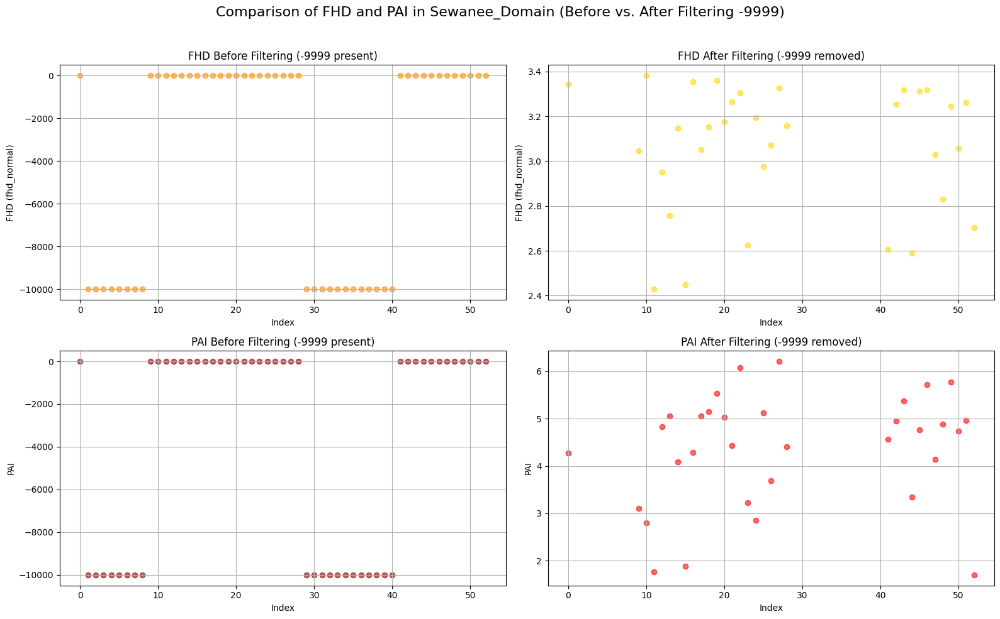

In [87]:
import matplotlib.pyplot as plt

# Filter out -9999 values
Sewanee_Domain_fhd_filtered = Sewanee_Domain[Sewanee_Domain['fhd_normal'] != -9999]
Sewanee_Domain_pai_filtered = Sewanee_Domain[Sewanee_Domain['pai'] != -9999]

# Create 2x2 subplot grid
fig, axes = plt.subplots(2, 2, figsize=(16, 10))

# --- Row 1: FHD (fhd_normal) ---
# Unfiltered
axes[0, 0].scatter(Sewanee_Domain.index, Sewanee_Domain['fhd_normal'], c='darkorange', alpha=0.6)
axes[0, 0].set_title('FHD Before Filtering (-9999 present)', fontsize=12)
axes[0, 0].set_ylabel('FHD (fhd_normal)')
axes[0, 0].set_xlabel('Index')
axes[0, 0].grid(True)

# Filtered
axes[0, 1].scatter(Sewanee_Domain_fhd_filtered.index, Sewanee_Domain_fhd_filtered['fhd_normal'], c='gold', alpha=0.6)
axes[0, 1].set_title('FHD After Filtering (-9999 removed)', fontsize=12)
axes[0, 1].set_ylabel('FHD (fhd_normal)')
axes[0, 1].set_xlabel('Index')
axes[0, 1].grid(True)

# --- Row 2: PAI ---
# Unfiltered
axes[1, 0].scatter(Sewanee_Domain.index, Sewanee_Domain['pai'], c='darkred', alpha=0.6)
axes[1, 0].set_title('PAI Before Filtering (-9999 present)', fontsize=12)
axes[1, 0].set_ylabel('PAI')
axes[1, 0].set_xlabel('Index')
axes[1, 0].grid(True)

# Filtered
axes[1, 1].scatter(Sewanee_Domain_pai_filtered.index, Sewanee_Domain_pai_filtered['pai'], c='red', alpha=0.6)
axes[1, 1].set_title('PAI After Filtering (-9999 removed)', fontsize=12)
axes[1, 1].set_ylabel('PAI')
axes[1, 1].set_xlabel('Index')
axes[1, 1].grid(True)

# Main title and layout
fig.suptitle('Comparison of FHD and PAI in Sewanee_Domain (Before vs. After Filtering -9999)', fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()


# Filtered Data

Filter the FHD and PAI by dropping -9999 no data values

Filter our the quality flag to only include high qulaity obervations

In [56]:
# Create a new dictionary to hold the filtered GeoDataFrames
filtered_geo_dfs = {}

for aoi_name, gdf in geo_dfs.items():
    # Ensure required columns exist before filtering
    required_cols = ['l2b_quality_flag', 'fhd_normal', 'pai']
    if all(col in gdf.columns for col in required_cols):
        filtered = gdf[
            (gdf['l2b_quality_flag'] == 1) &
            (gdf['fhd_normal'] != -9999) &
            (gdf['pai'] != -9999)
        ].copy()
        filtered_geo_dfs[aoi_name] = filtered
        print(f"{aoi_name}: {len(filtered)} observations retained.")
    else:
        print(f"{aoi_name}: missing one or more required columns, skipped.")


SPB_AOI: 1371 observations retained.
Prescribed_Burn_AOI: 78 observations retained.
PaintRock_AOI: 6822 observations retained.
Sewanee_Domain: 31 observations retained.


/tmp/ipython-input-74-1445628287.py:21: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = get_cmap('plasma')


AttributeError: 'NoneType' object has no attribute 'canvas'

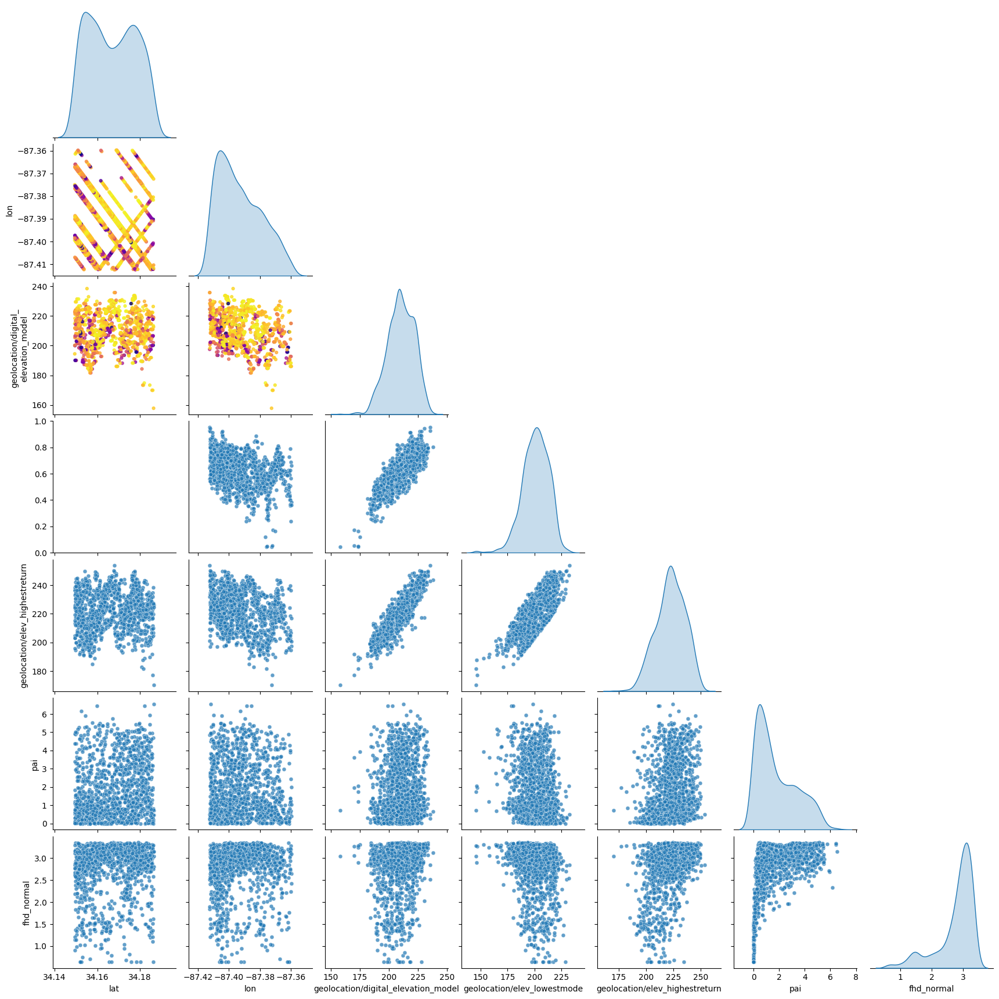

In [74]:
#### Pairplot on the filtered datasets
#### This consolidates all sites and displays the genral behavior of the data
for aoi_name, gdf in filtered_geo_dfs.items():
    # Select numeric columns only
    numeric_cols = gdf.select_dtypes(include=[np.number]).columns.tolist()
    if 'fhd_normal' not in numeric_cols or gdf.empty:
        print(f"Skipping {aoi_name} (no numeric data or missing fhd_normal)")
        continue

    # Drop NaNs for numeric fields only
    plot_df = gdf[numeric_cols].dropna()

    # Normalize fhd_normal for coloring
    norm = Normalize(vmin=plot_df['fhd_normal'].min(), vmax=plot_df['fhd_normal'].max())
    cmap = get_cmap('plasma')
    colors = cmap(norm(plot_df['fhd_normal'].values))

    # Create pairplot
    pair_grid = sns.pairplot(
        plot_df,
        corner=True,
        plot_kws={'s': 25, 'alpha': 0.7},
        diag_kind='kde'
    )

    # Apply color manually to lower triangle scatterplots
    for i, j in zip(*np.tril_indices_from(pair_grid.axes, -1)):
        ax = pair_grid.axes[i, j]
        x = plot_df.iloc[:, j]
        y = plot_df.iloc[:, i]
        ax.clear()
        ax.scatter(x, y, c=colors, s=12, alpha=0.8)

        # Verbose and wrapped labels
        xlabel = textwrap.fill(plot_df.columns[j], 20)
        ylabel = textwrap.fill(plot_df.columns[i], 20)
        ax.set_xlabel(xlabel, fontsize=10)
        ax.set_ylabel(ylabel, fontsize=10)

    # Ensure all axis tick labels are visible and readable
    for ax_row in pair_grid.axes:
        for ax in ax_row:
            if ax:
                ax.tick_params(labelsize=8)
                if ax.get_xlabel():
                    ax.set_xlabel(textwrap.fill(ax.get_xlabel(), 20), fontsize=9)
                if ax.get_ylabel():
                    ax.set_ylabel(textwrap.fill(ax.get_ylabel(), 20), fontsize=9)

    # Add colorbar
    sm = ScalarMappable(cmap=cmap, norm=norm)
    sm.set_array([])
    pair_grid.fig.colorbar(sm, ax=pair_grid.fig.axes, label='FHD Normal', shrink=0.6, pad=0.03)

    # Title and layout
    pair_grid.fig.suptitle(
        f"Pair Plot of GEDI Metrics - Colored by FHD Normal\nAOI: {aoi_name}",
        y=1.02,
        fontsize=14
    )
    plt.tight_layout()
    plt.show()


In [88]:
SPB_AOI_filtered = filtered_geo_dfs.get('SPB_AOI', gp.GeoDataFrame())
Prescribed_Burn_AOI_filtered = filtered_geo_dfs.get('Prescribed_Burn_AOI', gp.GeoDataFrame())
PaintRock_AOI_filtered = filtered_geo_dfs.get('PaintRock_AOI', gp.GeoDataFrame())
Sewanee_Domain_filtered = filtered_geo_dfs.get('Sewanee_Domain', gp.GeoDataFrame())

Sewanee_Domain_filtered.head()

,lat,lon,geolocation/degrade_flag,geolocation/digital_elevation_model,geolocation/elev_lowestmode,geolocation/elev_highestreturn,l2b_quality_flag,rh100,pai,fhd_normal,product,Beam,fileName,date,geometry
10,34.774928,-86.307015,0,233.313324,205.675064,237.709747,1,3202,2.798551,3.381701,GEDI_L2B,BEAM1011,GEDI02_B_2019168204100_O02904_03_T04427_02_003...,2019-06-17 20:41:00,POINT (-86.30702 34.77493)
11,34.774582,-86.306556,0,233.313324,227.876328,241.616150,1,1372,1.769525,2.428684,GEDI_L2B,BEAM1011,GEDI02_B_2019168204100_O02904_03_T04427_02_003...,2019-06-17 20:41:00,POINT (-86.30656 34.77458)
12,34.774219,-86.306109,0,234.455063,224.434616,246.351105,1,2190,4.834318,2.951555,GEDI_L2B,BEAM1011,GEDI02_B_2019168204100_O02904_03_T04427_02_003...,2019-06-17 20:41:00,POINT (-86.30611 34.77422)
13,34.773859,-86.305660,0,234.455063,224.022095,243.922409,1,1989,5.059941,2.758065,GEDI_L2B,BEAM1011,GEDI02_B_2019168204100_O02904_03_T04427_02_003...,2019-06-17 20:41:00,POINT (-86.30566 34.77386)
14,34.773496,-86.305213,0,238.647110,220.677078,246.364532,1,2568,4.083013,3.148449,GEDI_L2B,BEAM1011,GEDI02_B_2019168204100_O02904_03_T04427_02_003...,2019-06-17 20:41:00,POINT (-86.30521 34.7735)


# Plot and Explore the data

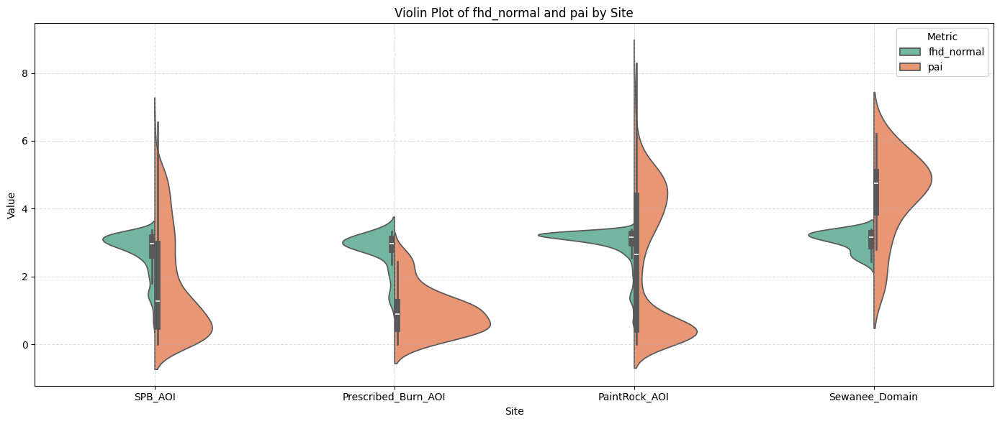

In [89]:
## create violin plots for PAI and FHD per AOI
# Prepare data from filtered_geo_dfs
fhd_data = []
pai_data = []

for site, gdf in filtered_geo_dfs.items():
    if not gdf.empty:
        if 'fhd_normal' in gdf.columns:
            temp_fhd = gdf[['fhd_normal']].copy()
            temp_fhd['site'] = site
            temp_fhd['metric'] = 'fhd_normal'
            temp_fhd.rename(columns={'fhd_normal': 'value'}, inplace=True)
            fhd_data.append(temp_fhd)

        if 'pai' in gdf.columns:
            temp_pai = gdf[['pai']].copy()
            temp_pai['site'] = site
            temp_pai['metric'] = 'pai'
            temp_pai.rename(columns={'pai': 'value'}, inplace=True)
            pai_data.append(temp_pai)

# Combine both metrics
combined_df = pd.concat(fhd_data + pai_data, ignore_index=True)

# Plot as violin plots
plt.figure(figsize=(14, 6))
sns.violinplot(data=combined_df, x='site', y='value', hue='metric', palette='Set2', split=True)
plt.title("Violin Plot of fhd_normal and pai by Site")
plt.ylabel("Value")
plt.xlabel("Site")
plt.legend(title="Metric")
plt.grid(True, linestyle='--', alpha=0.4)
plt.tight_layout()
plt.show()


In [ ]:
# # Combine and filter fhd_normal values from all sites
# fhd_data = []

# for site, gdf in geo_dfs.items():
#     if not gdf.empty and 'fhd_normal' in gdf.columns:
#         # Drop rows where fhd_normal is -9999 or NaN
#         filtered = gdf[(gdf['fhd_normal'] != -9999) & (gdf['fhd_normal'] != -999999)].copy()
#         if not filtered.empty:
#             temp_df = filtered[['fhd_normal']].copy()
#             temp_df['site'] = site
#             fhd_data.append(temp_df)

# # Combine into one DataFrame
# combined_df = pd.concat(fhd_data, ignore_index=True)

# # Plot
# plt.figure(figsize=(12, 6))
# sns.stripplot(data=combined_df, x='site', y='fhd_normal', jitter=True, palette='Set2')
# plt.title("FHD Normal Values by Site (Filtered)")
# plt.ylabel("fhd_normal")
# plt.xlabel("Site")
# plt.grid(True, linestyle='--', alpha=0.5)
# plt.tight_layout()
# plt.show()


In [62]:
## Map both FHD and PAI per AOI
## explore the map and click on the observatiosn to diplay the values

# Initialize map centered on average coordinates of all sites combined
all_lats = []
all_lons = []

for df in filtered_geo_dfs.values():
    all_lats.extend(df['lat'].tolist())
    all_lons.extend(df['lon'].tolist())

map_center = [sum(all_lats) / len(all_lats), sum(all_lons) / len(all_lons)]
m = folium.Map(location=map_center, zoom_start=8)

# Define colormap and normalization globally for consistent coloring

# Combine all FHD and PAI values for normalization
all_fhd_values = pd.concat([df['fhd_normal'] for df in filtered_geo_dfs.values()])
all_pai_values = pd.concat([df['pai'] for df in filtered_geo_dfs.values()])

norm_fhd = colors.Normalize(vmin=all_fhd_values.min(), vmax=all_fhd_values.max())
norm_pai = colors.Normalize(vmin=all_pai_values.min(), vmax=all_pai_values.max())
cmap = cm.get_cmap('viridis')

# Add each AOI as separate FeatureGroups for FHD and PAI
for site_name, df in filtered_geo_dfs.items():
    fg_fhd = folium.FeatureGroup(name=f"{site_name} - FHD")
    fg_pai = folium.FeatureGroup(name=f"{site_name} - PAI")

    for _, row in df.iterrows():
        lat, lon = row['lat'], row['lon']

        # FHD marker
        fhd_value = row['fhd_normal']
        if pd.notnull(fhd_value):
            color_fhd = colors.to_hex(cmap(norm_fhd(fhd_value)))
            folium.CircleMarker(
                location=(lat, lon),
                radius=3,
                color=color_fhd,
                fill=True,
                fill_color=color_fhd,
                fill_opacity=0.8,
                popup=f"FHD: {fhd_value:.2f}"
            ).add_to(fg_fhd)

        # PAI marker
        pai_value = row['pai']
        if pd.notnull(pai_value):
            color_pai = colors.to_hex(cmap(norm_pai(pai_value)))
            folium.CircleMarker(
                location=(lat, lon),
                radius=3,
                color=color_pai,
                fill=True,
                fill_color=color_pai,
                fill_opacity=0.8,
                popup=f"PAI: {pai_value:.2f}"
            ).add_to(fg_pai)

    fg_fhd.add_to(m)
    fg_pai.add_to(m)

# Add layer control to toggle layers on/off
folium.LayerControl(collapsed=False).add_to(m)

# Save and display
m.save('filtered_gedi_fhd_pai_map.html')
m


/tmp/ipython-input-62-2804444563.py:25: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap('viridis')


In [ ]:
# import folium
# from matplotlib import cm, colors
# import pandas as pd

# # Initialize map centered on average coordinates of all sites combined
# all_lats = []
# all_lons = []

# for df in geo_dfs.values():
#     filtered = df[df['fhd_normal'] != -9999]
#     all_lats.extend(filtered['lat'].tolist())
#     all_lons.extend(filtered['lon'].tolist())

# map_center = [sum(all_lats) / len(all_lats), sum(all_lons) / len(all_lons)]
# m = folium.Map(location=map_center, zoom_start=8)

# # Define colormap and normalization globally for consistent coloring
# all_fhd_values = pd.concat([df[df['fhd_normal'] != -9999]['fhd_normal'] for df in geo_dfs.values()])
# norm = colors.Normalize(vmin=all_fhd_values.min(), vmax=all_fhd_values.max())
# cmap = cm.get_cmap('viridis')

# # Add each AOI as a separate FeatureGroup with colored CircleMarkers
# for site_name, df in geo_dfs.items():
#     fg = folium.FeatureGroup(name=site_name)
#     filtered = df[df['fhd_normal'] != -9999]

#     for _, row in filtered.iterrows():
#         rh_value = row['fhd_normal']
#         if pd.notnull(rh_value):
#             color = colors.to_hex(cmap(norm(rh_value)))
#             folium.CircleMarker(
#                 location=(row['lat'], row['lon']),
#                 radius=3,
#                 color=color,
#                 fill=True,
#                 fill_color=color,
#                 fill_opacity=0.8,
#             ).add_to(fg)

#     fg.add_to(m)

# # Add layer control to toggle AOIs on/off
# folium.LayerControl().add_to(m)

# # Save and display
# m.save('combined_gedi_map.html')
# m


/tmp/ipython-input-64-261629437.py:54: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 0.95])


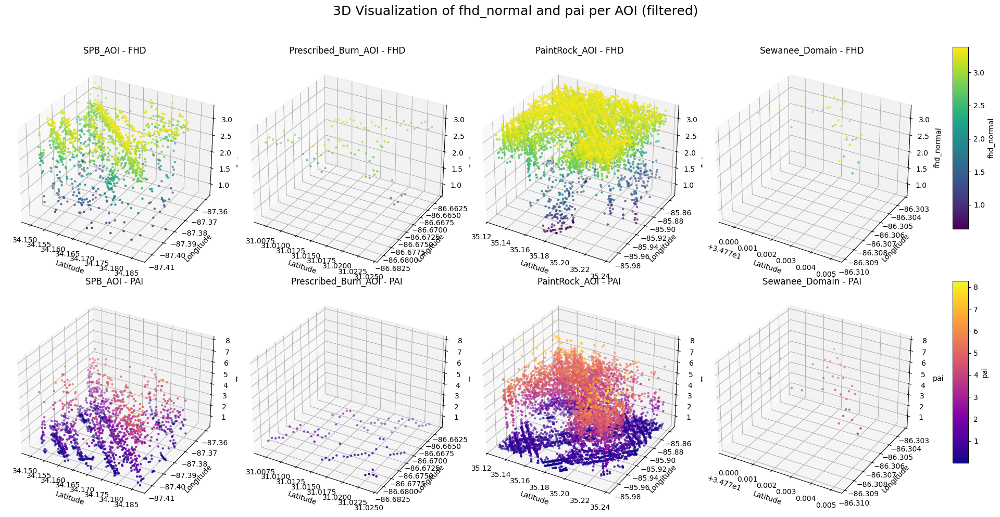

In [64]:
## 3D pltos of quality filtered FHD and PAI

# Prepare figure with 2 rows (FHD on top, PAI below), columns = number of AOIs
num_aois = len(filtered_geo_dfs)
fig = plt.figure(figsize=(5 * num_aois, 10))  # width scaled by number of AOIs, height for 2 rows

# Find global min/max for color normalization for fhd_normal and pai
fhd_min = min(df['fhd_normal'].min() for df in filtered_geo_dfs.values())
fhd_max = max(df['fhd_normal'].max() for df in filtered_geo_dfs.values())
pai_min = min(df['pai'].min() for df in filtered_geo_dfs.values())
pai_max = max(df['pai'].max() for df in filtered_geo_dfs.values())

for i, (aoi_name, df) in enumerate(filtered_geo_dfs.items(), start=1):
    # Top row: fhd_normal scatter
    ax1 = fig.add_subplot(2, num_aois, i, projection='3d')
    x = df['lat']
    y = df['lon']
    z = df['fhd_normal']
    colors = z
    scatter = ax1.scatter(x, y, z, c=colors, cmap='viridis', s=5, vmin=fhd_min, vmax=fhd_max)
    ax1.set_xlabel('Latitude')
    ax1.set_ylabel('Longitude')
    ax1.set_zlabel('fhd_normal')
    ax1.set_title(f"{aoi_name} - FHD")
    ax1.set_zlim(fhd_min, fhd_max)

    # Bottom row: pai scatter
    ax2 = fig.add_subplot(2, num_aois, i + num_aois, projection='3d')
    z2 = df['pai']
    colors2 = z2
    scatter2 = ax2.scatter(x, y, z2, c=colors2, cmap='plasma', s=5, vmin=pai_min, vmax=pai_max)
    ax2.set_xlabel('Latitude')
    ax2.set_ylabel('Longitude')
    ax2.set_zlabel('pai')
    ax2.set_title(f"{aoi_name} - PAI")
    ax2.set_zlim(pai_min, pai_max)

# Add shared colorbars on right side
cbar_ax_fhd = fig.add_axes([0.92, 0.55, 0.015, 0.35])
norm_fhd = plt.Normalize(vmin=fhd_min, vmax=fhd_max)
cbar_fhd = plt.colorbar(plt.cm.ScalarMappable(norm=norm_fhd, cmap='viridis'), cax=cbar_ax_fhd)
cbar_fhd.set_label('fhd_normal')

cbar_ax_pai = fig.add_axes([0.92, 0.1, 0.015, 0.35])
norm_pai = plt.Normalize(vmin=pai_min, vmax=pai_max)
cbar_pai = plt.colorbar(plt.cm.ScalarMappable(norm=norm_pai, cmap='plasma'), cax=cbar_ax_pai)
cbar_pai.set_label('pai')

plt.suptitle('3D Visualization of fhd_normal and pai per AOI (filtered)', fontsize=18)
plt.tight_layout(rect=[0, 0, 0.9, 0.95])
plt.show()


In [ ]:
# import matplotlib.pyplot as plt
# from mpl_toolkits.mplot3d import Axes3D
# import numpy as np

# # Clean and filter each GeoDataFrame: drop NaNs and filter out -9999 in 'fhd_normal'
# filtered_geo_dfs = {}
# for aoi_name, gdf in geo_dfs.items():
#     if not gdf.empty:
#         df_clean = gdf.dropna(subset=['lat', 'lon', 'fhd_normal'])
#         df_clean = df_clean[df_clean['fhd_normal'] != -9999]
#         if not df_clean.empty:
#             filtered_geo_dfs[aoi_name] = df_clean

# fig = plt.figure(figsize=(20, 5))  # wide figure for 4 plots

# for i, (aoi_name, df) in enumerate(filtered_geo_dfs.items(), start=1):
#     ax = fig.add_subplot(1, 4, i, projection='3d')

#     x = df['lat']
#     y = df['lon']
#     z = df['fhd_normal']
#     colors = z
#     color_min = colors.min()
#     color_max = colors.max()

#     scatter = ax.scatter(x, y, z, c=colors, cmap='viridis', s=5, vmin=color_min, vmax=color_max)

#     ax.set_xlabel('Latitude')
#     ax.set_ylabel('Longitude')
#     ax.set_zlabel('fhd_normal')
#     ax.set_title(aoi_name)
#     ax.set_zlim(color_min, color_max)

# # Add shared colorbar on right side
# cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])
# norm = plt.Normalize(vmin=min(df['fhd_normal'].min() for df in filtered_geo_dfs.values()),
#                      vmax=max(df['fhd_normal'].max() for df in filtered_geo_dfs.values()))
# cbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap='viridis'), cax=cbar_ax)
# cbar.set_label('fhd_normal')

# plt.suptitle('3D fhd_normal Visualization for all AOIs (filtered)', fontsize=16)
# plt.tight_layout(rect=[0, 0, 0.9, 1])
# plt.show()


In [ ]:
# import matplotlib.pyplot as plt

# # Number of AOIs
# num_aois = len(geo_dfs)
# fig, axes = plt.subplots(num_aois, 1, figsize=(10, 5 * num_aois), sharex=True)

# if num_aois == 1:
#     axes = [axes]  # Ensure axes is iterable

# for ax, (aoi_name, gdf) in zip(axes, geo_dfs.items()):
#     # Drop rows with missing elevation data
#     df = gdf.dropna(subset=['geolocation/digital_elevation_model'])

#     # Plot digital elevation model (DEM) vs. index
#     ax.scatter(df.index, df['geolocation/digital_elevation_model'], s=5, alpha=0.7)
#     ax.set_title(f"{aoi_name} - Digital Elevation Model")
#     ax.set_ylabel("Elevation (m)")
#     ax.grid(True)

# axes[-1].set_xlabel("Observation Index")
# plt.tight_layout()
# plt.show()


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
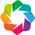

In [65]:
import holoviews as hv
hv.extension('bokeh')

def plot_transect_elevations(filtered_gdf, transect_col='Beam', output_title_prefix='GEDI Beam'):
    """
    Generate elevation transect plots per unique beam in the dataframe.

    Parameters:
    - filtered_gdf: pd.DataFrame or GeoDataFrame with GEDI data.
    - transect_col: str, name of column identifying beam/transect (default: 'Beam')
    - output_title_prefix: str, prefix for plot titles (default: 'GEDI Beam')

    Returns:
    - plots_dict: dict of {beam_name: hv.Overlay} of the combined scatter plots
    """
    plots_dict = {}

    for transect_name, group_df in filtered_gdf.groupby(transect_col):
        group_df = group_df.dropna(subset=[
            'geolocation/digital_elevation_model',
            'geolocation/elev_lowestmode',
            'geolocation/elev_highestreturn'
        ]).copy()

        x_vals = range(len(group_df))

        demVis = hv.Scatter((x_vals, group_df['geolocation/digital_elevation_model']),
                            label='DEM (GEDI)').opts(color='black', size=1.5)

        zVis = hv.Scatter((x_vals, group_df['geolocation/elev_lowestmode']),
                          label='Elev lowestmode -> Lowest Mode Elevation').opts(color='saddlebrown', size=1.5)

        rhVis = hv.Scatter((x_vals, group_df['geolocation/elev_highestreturn']),
                           label='Highest Return -> Canopy Top Elevation').opts(color='darkgreen', size=1.5, tools=['hover'])

        combined = (demVis * zVis * rhVis).opts(
            title=f'{output_title_prefix} {transect_name} Elevation Profile',
            height=500, width=900,
            show_legend=True, legend_position='top_left',
            xlabel='Observation Index', ylabel='Elevation (m)',
            fontsize={'title': 14, 'xlabel': 16, 'ylabel': 16}
        )

        plots_dict[transect_name] = combined

    return plots_dict

# Apply to each AOI in filtered_geo_dfs (already cleaned)
all_plots = {}

for aoi_name, gdf in filtered_geo_dfs.items():
    if gdf.empty:
        print(f"No valid data for {aoi_name}")
        continue

    plots = plot_transect_elevations(gdf, transect_col='Beam', output_title_prefix=f'GEDI {aoi_name}')
    all_plots[aoi_name] = plots

# Example: display all transects for one AOI, e.g., 'SPB_AOI'
if 'SPB_AOI' in all_plots:
    hv.Layout(all_plots['SPB_AOI'].values()).cols(1)


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
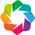

In [46]:
# import holoviews as hv
# hv.extension('bokeh')

# def plot_transect_elevations(filtered_gdf, transect_col='Beam', output_title_prefix='GEDI Beam'):
#     """
#     Generate elevation transect plots per unique beam in the dataframe.

#     Parameters:
#     - filtered_gdf: pd.DataFrame or GeoDataFrame with GEDI data.
#     - transect_col: str, name of column identifying beam/transect (default: 'Beam')
#     - output_title_prefix: str, prefix for plot titles (default: 'GEDI Beam')

#     Returns:
#     - plots_dict: dict of {beam_name: hv.Overlay} of the combined scatter plots
#     """
#     plots_dict = {}

#     for transect_name, group_df in filtered_gdf.groupby(transect_col):
#         group_df = group_df.dropna(subset=[
#             'geolocation/digital_elevation_model',
#             'geolocation/elev_lowestmode',
#             'geolocation/elev_highestreturn'
#         ]).copy()

#         x_vals = range(len(group_df))

#         demVis = hv.Scatter((x_vals, group_df['geolocation/digital_elevation_model']),
#                             label='DEM (GEDI)').opts(color='black', size=1.5)

#         zVis = hv.Scatter((x_vals, group_df['geolocation/elev_lowestmode']),
#                           label='Lowest Mode Elevation').opts(color='saddlebrown', size=1.5)

#         rhVis = hv.Scatter((x_vals, group_df['geolocation/elev_highestreturn']),
#                            label='Canopy Top Elevation').opts(color='darkgreen', size=1.5, tools=['hover'])

#         combined = (demVis * zVis * rhVis).opts(
#             title=f'{output_title_prefix} {transect_name} Elevation Profile',
#             height=500, width=900,
#             show_legend=True, legend_position='top_left',
#             xlabel='Observation Index', ylabel='Elevation (m)',
#             fontsize={'title': 14, 'xlabel': 16, 'ylabel': 16}
#         )

#         plots_dict[transect_name] = combined

#     return plots_dict


# # Now apply this to each GeoDataFrame in geo_dfs, filtering out fhd_normal == -9999 first:

# all_plots = {}

# for aoi_name, gdf in geo_dfs.items():
#     # Filter out invalid fhd_normal values
#     filtered_gdf = gdf[gdf['fhd_normal'] != -9999].copy()
#     if filtered_gdf.empty:
#         print(f"No valid data for {aoi_name} after filtering fhd_normal")
#         continue

#     plots = plot_transect_elevations(filtered_gdf, transect_col='Beam', output_title_prefix=f'GEDI {aoi_name}')
#     all_plots[aoi_name] = plots

# # Example: display all transects for one AOI, e.g., 'SPB_AOI'
# if 'SPB_AOI' in all_plots:
#     hv.Layout(all_plots['SPB_AOI'].values()).cols(1)


In [67]:
# plot elevation per beam i.e Beam1011 and per AOI.
# Press enter to procude the next set of plots
# these charts are interactive, zoom in and out to explore the data further

for aoi_name, plots_dict in all_plots.items():
    print(f"Displaying transect plots for AOI: {aoi_name}")
    layout = hv.Layout(plots_dict.values()).cols(1)
    display(layout)  # In Jupyter/Colab this will render the plot
    # Optionally add a pause or break here to show one AOI at a time
    input("Press Enter to continue to the next AOI...")


Displaying transect plots for AOI: SPB_AOI


:Layout
   .Overlay.I   :Overlay
      .Scatter.DEM_left_parenthesis_GEDI_right_parenthesis :Scatter   [x]   (y)
      .Scatter.Lowest_Mode_Elevation                       :Scatter   [x]   (y)
      .Scatter.Canopy_Top_Elevation                        :Scatter   [x]   (y)
   .Overlay.II  :Overlay
      .Scatter.DEM_left_parenthesis_GEDI_right_parenthesis :Scatter   [x]   (y)
      .Scatter.Lowest_Mode_Elevation                       :Scatter   [x]   (y)
      .Scatter.Canopy_Top_Elevation                        :Scatter   [x]   (y)
   .Overlay.III :Overlay
      .Scatter.DEM_left_parenthesis_GEDI_right_parenthesis :Scatter   [x]   (y)
      .Scatter.Lowest_Mode_Elevation                       :Scatter   [x]   (y)
      .Scatter.Canopy_Top_Elevation                        :Scatter   [x]   (y)
   .Overlay.IV  :Overlay
      .Scatter.DEM_left_parenthesis_GEDI_right_parenthesis :Scatter   [x]   (y)
      .Scatter.Lowest_Mode_Elevation                       :Scatter   [x]   (y)
      .Scatter.Canopy_Top_Elevation                        :Scatter   [x]   (y)

Press Enter to continue to the next AOI...
Displaying transect plots for AOI: Prescribed_Burn_AOI


:Layout
   .Overlay.I   :Overlay
      .Scatter.DEM_left_parenthesis_GEDI_right_parenthesis :Scatter   [x]   (y)
      .Scatter.Lowest_Mode_Elevation                       :Scatter   [x]   (y)
      .Scatter.Canopy_Top_Elevation                        :Scatter   [x]   (y)
   .Overlay.II  :Overlay
      .Scatter.DEM_left_parenthesis_GEDI_right_parenthesis :Scatter   [x]   (y)
      .Scatter.Lowest_Mode_Elevation                       :Scatter   [x]   (y)
      .Scatter.Canopy_Top_Elevation                        :Scatter   [x]   (y)
   .Overlay.III :Overlay
      .Scatter.DEM_left_parenthesis_GEDI_right_parenthesis :Scatter   [x]   (y)
      .Scatter.Lowest_Mode_Elevation                       :Scatter   [x]   (y)
      .Scatter.Canopy_Top_Elevation                        :Scatter   [x]   (y)

Press Enter to continue to the next AOI...
Displaying transect plots for AOI: PaintRock_AOI


:Layout
   .Overlay.I   :Overlay
      .Scatter.DEM_left_parenthesis_GEDI_right_parenthesis :Scatter   [x]   (y)
      .Scatter.Lowest_Mode_Elevation                       :Scatter   [x]   (y)
      .Scatter.Canopy_Top_Elevation                        :Scatter   [x]   (y)
   .Overlay.II  :Overlay
      .Scatter.DEM_left_parenthesis_GEDI_right_parenthesis :Scatter   [x]   (y)
      .Scatter.Lowest_Mode_Elevation                       :Scatter   [x]   (y)
      .Scatter.Canopy_Top_Elevation                        :Scatter   [x]   (y)
   .Overlay.III :Overlay
      .Scatter.DEM_left_parenthesis_GEDI_right_parenthesis :Scatter   [x]   (y)
      .Scatter.Lowest_Mode_Elevation                       :Scatter   [x]   (y)
      .Scatter.Canopy_Top_Elevation                        :Scatter   [x]   (y)
   .Overlay.IV  :Overlay
      .Scatter.DEM_left_parenthesis_GEDI_right_parenthesis :Scatter   [x]   (y)
      .Scatter.Lowest_Mode_Elevation                       :Scatter   [x]   (y)
      .Scatter.Canopy_Top_Elevation                        :Scatter   [x]   (y)

Press Enter to continue to the next AOI...
Displaying transect plots for AOI: Sewanee_Domain


:Layout
   .Overlay.I   :Overlay
      .Scatter.DEM_left_parenthesis_GEDI_right_parenthesis :Scatter   [x]   (y)
      .Scatter.Lowest_Mode_Elevation                       :Scatter   [x]   (y)
      .Scatter.Canopy_Top_Elevation                        :Scatter   [x]   (y)
   .Overlay.II  :Overlay
      .Scatter.DEM_left_parenthesis_GEDI_right_parenthesis :Scatter   [x]   (y)
      .Scatter.Lowest_Mode_Elevation                       :Scatter   [x]   (y)
      .Scatter.Canopy_Top_Elevation                        :Scatter   [x]   (y)
   .Overlay.III :Overlay
      .Scatter.DEM_left_parenthesis_GEDI_right_parenthesis :Scatter   [x]   (y)
      .Scatter.Lowest_Mode_Elevation                       :Scatter   [x]   (y)
      .Scatter.Canopy_Top_Elevation                        :Scatter   [x]   (y)

Press Enter to continue to the next AOI...


##Contact Info:

Email: timothy.j.mayer@nasa.gov

Organization: SERVIR & Earth Hub

Website: XXXXXXXX

Date last modified: 06-24-2025


Funding for this work was provided through the cooperative agreement 80MSFC22N0004 between NASA and UAH. SERVIR is a joint NASA- and USAID-led program